<a href="https://colab.research.google.com/github/ibrahimwichka/Celiac-Informatics-Web-App/blob/master/Final_Model_rdkit_fingerprints_descriptors.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Predicting bioactivity of potential ligands with transglutaminase 2 (Celiac Disease)

*Ibrahim Wichka & Prof. Pin-Kuang Lai (Stevens Institute of Technology)*

Web App: [Insert Here]

Paper: [Insert Here]

## Step 1: Data Preprocessing

1.1: Import dataset and libraries and begin to clean dataset

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sn
import numpy as np

In [ ]:
!pip install rdkit
from rdkit import Chem
from rdkit.Chem import AllChem
from rdkit.Chem import Draw
#----------------------------------------------------
import numpy as np
import pandas as pd

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 26.2 MB/s eta 0:00:00


*** Note: The following cell contains instructions that do not need to be done to go through this tutorial. I am simply including it for the purpose of articulating data finding techniques

We must use a dataset from a biological assay of compounds tested against transglutaminase 2 (TG2). Many of these can be found on databases like:

CHEMBL (https://www.ebi.ac.uk/chembl/)
PubChem (https://pubchem.ncbi.nlm.nih.gov/)

We can get our dataset from Pubchem's TG2 assays and download a csv of it:

Pubchem Data Link:(https://pubchem.ncbi.nlm.nih.gov/gene/7052#section=Chemicals-and-Bioactivities&fullscreen=true)

CSV File: https://drive.google.com/file/d/118BhVnxCtB6jjo44cHrxVrKo_mYI4WWQ/view?usp=sharing


This dataset contains many columns but the only ones that we will really need are CID, Compound_Name, Type, Value, and Activity.

One thing not present in the dataset are the SMILES notation for all the molecules. These can be extracted from pubhcem manually put because our dataset is so large, this would be time consuming.

We can use the pubchempy api to get the smiles of all the molecules in the dataset. Here is a link to a notebook with a demonstration of this.

*** Note: The following instructions are mandatory.

For this tutorial simply download the file:  

CSV File: https://drive.google.com/file/d/1AJdjYbAE3cMFliJOib3Dc_u86JXn5-au/view?usp=sharing


Place it into the sample data for your demo of this tutorial.

You are now ready to do some bioactivity predictions!

Store the csv in a dataframe.

In [ ]:
df_master = pd.read_csv('TG2_compound_smiles.csv')
df_master

,CID,Compound_Name,Type,Value,Activity,Acqual,Smiles
0,28254071,"(6-Methyl-4-oxo-3,5-diphenyl-3,4-dihydro-thien...",IC50,0.16,Active,=,CC1=C(C2=C(S1)N=C(N(C2=O)C3=CC=CC=C3)SCC(=O)NN...
1,44391427,"2-[[3-(3-Fluorophenyl)-4-oxo-5-phenyl-5,6,7,8-...",IC50,0.17,Active,=,C1CC(C2=C(C1)SC3=C2C(=O)N(C(=N3)SCC(=O)NN)C4=C...
2,11784890,[6-Chloro-3-(3-fluoro-phenyl)-5-(2-fluoro-phen...,IC50,0.13,Active,=,C1=CC=C(C(=C1)C2=C(SC3=C2C(=O)N(C(=N3)SCC(=O)N...
3,44391463,[3-(3-Fluoro-phenyl)-5-(4-methoxy-phenyl)-4-ox...,IC50,0.28,Active,=,COC1=CC=C(C=C1)C2=CSC3=C2C(=O)N(C(=N3)SCC(=O)N...
4,1150683,"2-(4-Oxo-3,5-diphenylthieno[2,3-d]pyrimidin-2-...",IC50,0.25,Active,=,C1=CC=C(C=C1)C2=CSC3=C2C(=O)N(C(=N3)SCC(=O)NN)...
...,...,...,...,...,...,...,...
1125,5387156,(2E)-3-(3-nitrophenyl)-1-(pyridin-3-yl)prop-2-...,IC50,19.60,Unspecified,=,C1=CC(=CC(=C1)[N+](=O)[O-])C=CC(=O)C2=CN=CC=C2
1126,72950407,T4SR539Ykf,IC50,0.01,Unspecified,>,CCC(CC)CNC(=O)CN1C=CC=C(C1=O)NC(=O)C(CCC=CC(=O...
1127,146197612,Ac-Asn-Abu(Unk)-Glu-Gln-Val-Ser-Pro-Leu-OH,IC50,0.01,Unspecified,>,CC(C)CC(C(=O)O)NC(=O)C1CCCN1C(=O)C(CO)NC(=O)C(...
1128,146213718,"(2S)-1-[(2S)-2-[[(2S)-2-[[(2S)-2-[[(E,2S)-7-me...",IC50,0.01,Unspecified,>,CCCCC(C(=O)NC(C(C)CC)C(=O)NC(CC(C)C)C(=O)N1CCC...


In [ ]:
ac = len(df_master[df_master["Activity"] == "Active"])
inn = len(df_master[df_master["Activity"] == "Inactive"])
uns = len(df_master[df_master["Activity"] == "Unspecified"])
inc = len(df_master[df_master["Activity"] == "Inconclusive"])
print("Active: " + str(ac/1130))
print("Inactive: " + str(inn/1130))
print("Unspecified: " + str(uns/1130))
print("Inconclusive: " + str(inc/1130))

Active: 0.5495575221238939
Inactive: 0.09115044247787611
Unspecified: 0.31946902654867254
Inconclusive: 0.03982300884955752


We must first remove all duplicates from our dataset. Drug design biologists tend to perform repeated trials of a molecules but we will only need one trial and it will be better for training our model.

Depending on the method of smiles extraction you may have either isomeric or canonical smiles notations for your molecules.

We will either remove duplicates based on CID or SMILES based on some analysis. This an only be done with the distinctive canonical smiles.

We can convert each smiles notation to its canonical using the following.

In [ ]:
def canonical_smiles(smiles):
    mols = [Chem.MolFromSmiles(smi) for smi in smiles]
    smiles = [Chem.MolToSmiles(mol) for mol in mols]
    return smiles

Canon_SMILES = canonical_smiles(df_master.Smiles)
df_master["Smiles"] = Canon_SMILES
df_master

,CID,Compound_Name,Type,Value,Activity,Acqual,Smiles
0,28254071,"(6-Methyl-4-oxo-3,5-diphenyl-3,4-dihydro-thien...",IC50,0.16,Active,=,Cc1sc2nc(SCC(=O)NN)n(-c3ccccc3)c(=O)c2c1-c1ccccc1
1,44391427,"2-[[3-(3-Fluorophenyl)-4-oxo-5-phenyl-5,6,7,8-...",IC50,0.17,Active,=,NNC(=O)CSc1nc2sc3c(c2c(=O)n1-c1cccc(F)c1)C(c1c...
2,11784890,[6-Chloro-3-(3-fluoro-phenyl)-5-(2-fluoro-phen...,IC50,0.13,Active,=,NNC(=O)CSc1nc2sc(Cl)c(-c3ccccc3F)c2c(=O)n1-c1c...
3,44391463,[3-(3-Fluoro-phenyl)-5-(4-methoxy-phenyl)-4-ox...,IC50,0.28,Active,=,COc1ccc(-c2csc3nc(SCC(=O)NN)n(-c4cccc(F)c4)c(=...
4,1150683,"2-(4-Oxo-3,5-diphenylthieno[2,3-d]pyrimidin-2-...",IC50,0.25,Active,=,NNC(=O)CSc1nc2scc(-c3ccccc3)c2c(=O)n1-c1ccccc1
...,...,...,...,...,...,...,...
1125,5387156,(2E)-3-(3-nitrophenyl)-1-(pyridin-3-yl)prop-2-...,IC50,19.60,Unspecified,=,O=C(C=Cc1cccc([N+](=O)[O-])c1)c1cccnc1
1126,72950407,T4SR539Ykf,IC50,0.01,Unspecified,>,CCC(CC)CNC(=O)Cn1cccc(NC(=O)C(CCC=CC(=O)OC)NC(...
1127,146197612,Ac-Asn-Abu(Unk)-Glu-Gln-Val-Ser-Pro-Leu-OH,IC50,0.01,Unspecified,>,COC(=O)C=CCCC(NC(=O)C(CC(N)=O)NC(C)=O)C(=O)NC(...
1128,146213718,"(2S)-1-[(2S)-2-[[(2S)-2-[[(2S)-2-[[(E,2S)-7-me...",IC50,0.01,Unspecified,>,CCCCC(NC(=O)C(CCC=CC(=O)OC)NC(=O)C1CC(=O)CN1)C...


For now, let's remove duplicates based on CID. We will get to know whether this was the right move later.

In [ ]:
df = df_master.drop_duplicates(subset='CID')
df = df.reset_index(drop = True)
df

,CID,Compound_Name,Type,Value,Activity,Acqual,Smiles
0,28254071,"(6-Methyl-4-oxo-3,5-diphenyl-3,4-dihydro-thien...",IC50,0.16,Active,=,Cc1sc2nc(SCC(=O)NN)n(-c3ccccc3)c(=O)c2c1-c1ccccc1
1,44391427,"2-[[3-(3-Fluorophenyl)-4-oxo-5-phenyl-5,6,7,8-...",IC50,0.17,Active,=,NNC(=O)CSc1nc2sc3c(c2c(=O)n1-c1cccc(F)c1)C(c1c...
2,11784890,[6-Chloro-3-(3-fluoro-phenyl)-5-(2-fluoro-phen...,IC50,0.13,Active,=,NNC(=O)CSc1nc2sc(Cl)c(-c3ccccc3F)c2c(=O)n1-c1c...
3,44391463,[3-(3-Fluoro-phenyl)-5-(4-methoxy-phenyl)-4-ox...,IC50,0.28,Active,=,COc1ccc(-c2csc3nc(SCC(=O)NN)n(-c4cccc(F)c4)c(=...
4,1150683,"2-(4-Oxo-3,5-diphenylthieno[2,3-d]pyrimidin-2-...",IC50,0.25,Active,=,NNC(=O)CSc1nc2scc(-c3ccccc3)c2c(=O)n1-c1ccccc1
...,...,...,...,...,...,...,...
667,145951882,3-[2-[(E)-2-(3-nitrophenyl)ethenyl]oxiran-2-yl...,IC50,151.00,Unspecified,=,O=[N+]([O-])c1cccc(C=CC2(c3cccnc3)CO2)c1
668,145955913,4-[[4-[1-[(4-Nitrophenyl)methyl]triazole-4-car...,IC50,100.00,Unspecified,>,N#Cc1ccc(Cn2cc(C(=O)c3cn(Cc4ccc([N+](=O)[O-])c...
669,145962928,3-(Benzotriazole-1-carbonyl)-6-nitrochromen-2-one,IC50,145.00,Unspecified,=,O=C(c1cc2cc([N+](=O)[O-])ccc2oc1=O)n1nnc2ccccc21
670,145959648,[1-[(3-Nitrophenyl)methyl]triazol-4-yl]-[1-[(4...,IC50,100.00,Unspecified,>,O=C(c1cn(Cc2ccc([N+](=O)[O-])cc2)nn1)c1cn(Cc2c...


Let's now generate molecules that have the same smiles to determine whether they are duplicates that should be removed.

In [ ]:
df_grouped = df.groupby('Smiles')
for name, group in df_grouped:
    if len(group) > 1:
      print('Molecules with smiles', name, ':')
      for index, row in group.iterrows():
          print('  ', row['CID'], row['Compound_Name'])

Molecules with smiles C=CC(=O)NC1CCCN(S(=O)(=O)c2ccc(NC(=O)OCc3ccccc3)cc2)C1 :
   71451225 benzyl N-[4-[(3R)-3-(prop-2-enoylamino)piperidin-1-yl]sulfonylphenyl]carbamate
   71449435 benzyl N-[4-[(3S)-3-(prop-2-enoylamino)piperidin-1-yl]sulfonylphenyl]carbamate
Molecules with smiles C=CC(=O)NC1CCN(S(=O)(=O)c2ccc(NC(=O)OCc3ccccc3)cc2)C1 :
   71451226 benzyl N-[4-[(3S)-3-(prop-2-enoylamino)pyrrolidin-1-yl]sulfonylphenyl]carbamate
   71453043 benzyl N-[4-[(3R)-3-(prop-2-enoylamino)pyrrolidin-1-yl]sulfonylphenyl]carbamate
Molecules with smiles C=CC(=O)NCCCCC(NC(=O)Cc1ccccc1)C(=O)N1CCN(c2cccc(C)n2)CC1 :
   71462877 N-[(5S)-6-[4-(6-methylpyridin-2-yl)piperazin-1-yl]-6-oxo-5-[(2-phenylacetyl)amino]hexyl]prop-2-enamide
   145968062 N-[(5R)-6-[4-(6-methylpyridin-2-yl)piperazin-1-yl]-6-oxo-5-[(2-phenylacetyl)amino]hexyl]prop-2-enamide
Molecules with smiles C=CC(=O)Nc1ccc(S(=O)(=O)N2CCC(NC(=O)OCc3ccccc3)C2)cc1 :
   52939902 benzyl N-[(3R)-1-[4-(prop-2-enoylamino)phenyl]sulfonylpyrrolidin-3-yl]carb

When examining the groups of molecules with the same smiles notation, we can see that they have different CIDs indicating that they are technically different molecules.

What this tells us that these are likely isomers and it would be desirable to not get rid of these because isomers can prove to have different properties from each other.

Therefore, we will stick with duplicate removal by CID.

Let's disect our dataset now!

The molecules in the dataset can be broken down into 3-4 classes:
  Active,
  Inactive,
  Unspecified,
  Inconclusive

In [ ]:
df_active = df[df['Activity'] == "Active"]
df_inactive = df[df['Activity'] == "Inactive"]
df_unspecified = df[df['Activity'] == "Unspecified"]
df_inconclusive = df[df['Activity'] == "Inconclusive"]
print("Active: " + str(len(df_active)))
print("Inactive: " + str(len(df_inactive)))
print("Unspecified: " + str(len(df_unspecified)))
print("Inconclusive: " + str(len(df_inconclusive)))
print(len(df_active) + len(df_inactive) + len(df_unspecified) + len(df_inconclusive))

Active: 425
Inactive: 45
Unspecified: 177
Inconclusive: 25
672


In [ ]:
df_inactive

,CID,Compound_Name,Type,Value,Activity,Acqual,Smiles
450,45265922,"3-amino-2-benzoyl-6-oxo-7H-thieno[2,3-b]pyridi...",NaN,NaN,Inactive,NaN,Cl.Nc1c(C(=O)c2ccccc2)sc2[nH]c(=O)c(C(=O)O)cc12
451,44437815,H-Pro-Gln-Pro-Lys(Unk)-Leu-Pro-Phe-OH,NaN,NaN,Inactive,NaN,CC(C)CC(NC(=O)C(CCCCNC(=O)C=O)NC(=O)C1CCCN1C(=...
452,44437811,H-Pro-Gln-Pro-Agl(Unk)-Leu-Pro-Phe-OH,NaN,NaN,Inactive,NaN,CC(C)CC(NC(=O)C(NC(=O)C=O)NC(=O)C1CCCN1C(=O)C(...
453,44437816,Unk-Pro-Gln-Pro-Dab(Ac)-Leu-Pro-Phe-OH,NaN,NaN,Inactive,NaN,CC(=O)NCCC(NC(=O)C1CCCN1C(=O)C(CCC(N)=O)NC(=O)...
454,118722337,(1-methylbenzimidazol-2-yl)methyl (2S)-2-[[(5S...,NaN,NaN,Inactive,NaN,Cn1c(COC(=O)N2CCCC2C(=O)NCC2CC(Br)=NO2)nc2ccccc21
455,118722326,"(2,3-dimethoxyphenyl)methyl (2S)-2-[[(5S)-3-br...",NaN,NaN,Inactive,NaN,COc1cccc(COC(=O)N2CCCC2C(=O)NCC2CC(Br)=NO2)c1OC
456,118722336,1H-benzimidazol-2-ylmethyl (2S)-2-[[(5S)-3-bro...,NaN,NaN,Inactive,NaN,O=C(NCC1CC(Br)=NO1)C1CCCN1C(=O)OCc1nc2ccccc2[nH]1
457,135403657,Phosphoaminophosphonic acid-guanylate ester,NaN,NaN,Inactive,NaN,Nc1nc2c(ncn2C2OC(COP(=O)(O)OP(=O)(O)NP(=O)(O)O...
458,145972894,(Z)-1-(benzotriazol-1-yl)-4-methyl-3-(4-nitrop...,IC50,NaN,Inactive,NaN,CC(C)C(=CC(=O)n1nnc2ccccc21)c1ccc([N+](=O)[O-]...
459,145950717,[1-[(4-Fluorophenyl)methyl]triazol-4-yl]-[1-[(...,IC50,NaN,Inactive,NaN,O=C(c1cn(Cc2ccc(F)cc2)nn1)c1cn(Cc2ccc([N+](=O)...


Note that the dataset is very unbalanced between Active and Inactive molecules.

When training a classfication ML model, it would be most convenient to place a model into one of two classes, Active or Inactive with a balanced distribution of both. Our goal is to obtain a dataset of 50-65% Active molecules.

A common approach may be to assume that unspecified and inconclusive molecules are inactive and this indeed would create a more balanced dataset. In the case that there is ample information about these molecules to classify them as clearly "inactive", this method may be promising.

However, in most cases, such information is not available so the best approach would be to perform an analysis of a particular widespread property of these molecules and determine if they are likely to fit into one class.

1.2: Perform statistical analysis on active and unspecified molecules to create a more balanced set

IC50 is an excellent property to examine when predicting the binding of a molecule to a target protein. The lower the IC50, the better the binding affinity.

We have already determined that we want MORE inactive molecules in our dataset so we will perform this analysis on unspecified molecules t find those that are likely to be inactive.

In fact, we can also decrease the amount of active molecules in our dataset to obtain a lower percentage in the active class. What gives us the ability to apply analysis on these is the fact that there are a few active molecules which have mediocre IC50s and are not as likely to bind to TG2 as those with the lowest IC50s.

Create a dataframe with Active molecules and their IC50s

In [ ]:
df_active_IC50 = df[df['Activity'] == "Active"]
df_active_IC50_ranked = df_active_IC50.sort_values(by='Value')
df_active_IC50_ranked.reset_index(drop=True, inplace=True)
df_active_IC50_ranked

,CID,Compound_Name,Type,Value,Activity,Acqual,Smiles
0,73504704,(4-Methoxycarbonylphenyl)methyl 4-[2-[(2-bromo...,IC50,0.00210,Active,NaN,COC(=O)c1ccc(COC(=O)N2CCN(C(=O)CNC(=O)CBr)CC2)cc1
1,73775396,N-[2-[4-(adamantane-1-carbonyl)piperazin-1-yl]...,IC50,0.00390,Active,NaN,O=C(CBr)NCC(=O)N1CCN(C(=O)C23CC4CC(CC(C4)C2)C3...
2,73775533,N-[2-[4-[[5-(dimethylamino)-1-naphthyl]sulfony...,IC50,0.00600,Active,=,C=CC(=O)NCC(=O)N1CCN(S(=O)(=O)c2cccc3c(N(C)C)c...
3,73775247,1-Adamantylmethyl 4-[2-[(2-bromoacetyl)amino]a...,IC50,0.00629,Active,NaN,O=C(CBr)NCC(=O)N1CCN(C(=O)OCC23CC4CC(CC(C4)C2)...
4,73775246,(6-Methoxycarbonyl-2-naphthyl)methyl 4-[2-[(2-...,IC50,0.00665,Active,NaN,COC(=O)c1ccc2cc(COC(=O)N3CCN(C(=O)CNC(=O)CCl)C...
...,...,...,...,...,...,...,...
420,11433027,[(5S)-5-carboxy-2-oxo-5-[[(2S)-3-phenyl-2-(phe...,IC50,10.00000,Active,=,C[S+](C)CC(=O)CCC(NC(=O)C(Cc1ccccc1)NC(=O)OCc1...
421,54584760,(E)-6-chloro-3-(2-oxo-2-(pyridin-3-yl)ethylide...,NaN,NaN,Active,NaN,O=C1Nc2cc(Cl)ccc2C1=CC(=O)c1cccnc1
422,145968855,N-[(5S)-6-[4-(6-nitropyridin-2-yl)piperazin-1-...,NaN,NaN,Active,NaN,C=CC(=O)NCCCCC(NC(=O)Cc1ccccc1)C(=O)N1CCN(c2cc...
423,132024504,benzyl N-[(2S)-1-[4-[5-(dimethylamino)naphthal...,NaN,NaN,Active,NaN,C=CC(=O)NCCCCC(NC(=O)OCc1ccccc1)C(=O)N1CCN(S(=...


Construct a histogram using the IC50 values and observe the frequency of values in certain ranges using the 'bins' feature.

You may also want to pinpoint a smaller range of values which you can do by simply shrinking the df to molecules with values in that range

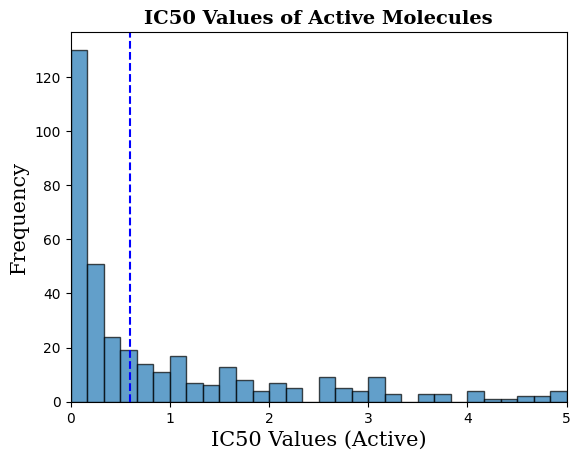

In [ ]:
plt.hist(df_active_IC50_ranked['Value'].to_numpy(), bins = 30, edgecolor='black', alpha=0.7, range=(0, 5))
plt.xlabel('IC50 Values (Active)', fontdict={'fontsize': 15, 'family': 'serif'})
plt.ylabel('Frequency', fontdict={'fontsize': 15, 'family': 'serif'})
plt.title('IC50 Values of Active Molecules', fontdict={'fontsize': 14, 'fontweight': 'bold', 'family': 'serif'})
plt.margins(x=0)
plt.axvline(x=0.6, color='blue', linestyle='--')
plt.show()

IC50 values below 1 are considered excellent binding affinities. Those molecules contain property values (descriptors or fingerprints) that are the easiest to train.

You can dive deeper by observing the frequency of certain values in the range (0, 1) and perhaps establish a threshold lower than 1 (in our case, <0.6 seemed plausible given the low frequency of molecules in the 0.7-1.0 range)

The same analysis can be applied to unspecified molecules with an emphasis on finding candidates for our training set that are likely to be inactive but not be so undrug-like that it causes our model to read irrelevant properties are determining factors of activity.

To achieve this, unspecified molecules in the range of IC50 values (10, 310) can be chosen. Molecules with an IC50 higher than 10 are likely to be inactive but those that are greater than 310 are likely to be overtly non-drug like and a bad source of learning

In [ ]:
df_unspecified_IC50 = df[df['Activity'] == "Unspecified"]
df_unspecified_IC50 = df_unspecified_IC50[df_unspecified_IC50["Value"] > 10]
df_unspecified_IC50 = df_unspecified_IC50[df_unspecified_IC50["Value"] < 350]
df_unspecified_IC50_ranked = df_unspecified_IC50.sort_values(by='Value')
df_unspecified_IC50_ranked.reset_index(drop=True, inplace=True)
df_unspecified_IC50_ranked

,CID,Compound_Name,Type,Value,Activity,Acqual,Smiles
0,16094751,"(S)-quinolin-3-ylmethyl 2-((((S)-3-bromo-4,5-d...",Ki,11.0,Unspecified,=,O=C(NCC1CC(Br)=NO1)C1CCCN1C(=O)OCc1cnc2ccccc2c1
1,56954826,Benzyl 4-[3-fluoro-4-(prop-2-enoylamino)phenyl...,IC50,13.0,Unspecified,=,C=CC(=O)Nc1ccc(S(=O)(=O)N2CCN(C(=O)OCc3ccccc3)...
2,71459389,(2S)-2-(naphthalen-1-ylmethoxycarbonylamino)-6...,IC50,14.0,Unspecified,=,C=CC(=O)NCCCCC(NC(=O)OCc1cccc2ccccc12)C(=O)O
3,71455728,(2S)-2-[(4-methylphenyl)methoxycarbonylamino]-...,IC50,14.0,Unspecified,=,C=CC(=O)NCCCCC(NC(=O)OCc1ccc(C)cc1)C(=O)O
4,145987285,N-[(5S)-6-[4-(6-nitropyridin-3-yl)piperazin-1-...,Ki,15.0,Unspecified,=,CCC(=O)NCCCCC(NC(=O)Cc1ccccc1)C(=O)N1CCN(c2ccc...
...,...,...,...,...,...,...,...
70,72205083,(2S)-5-oxo-2-[[2-(phenylmethoxycarbonylamino)a...,IC50,200.0,Unspecified,>,Cc1c(C)[n+](C)c(SCC(=O)CCC(NC(=O)CNC(=O)OCc2cc...
71,7054,Isatin,IC50,250.0,Unspecified,>,O=C1Nc2ccccc2C1=O
72,3798517,"1-{4-[(2,3-Dioxo-2,3-dihydro-1H-indol-1-YL)met...",IC50,250.0,Unspecified,>,Cc1cc(CN2C(=O)C(=O)c3ccccc32)c(C)cc1CN1C(=O)C(...
73,6020915,(E)-3-(3-hydroxyphenyl)-1-pyridin-3-ylprop-2-e...,IC50,266.0,Unspecified,=,O=C(C=Cc1cccc(O)c1)c1cccnc1


Construct another histogram, this time graphing the frequency of certain IC50 values in the unspecified set.

Once again, the range can be adjusted using 'bins' to allow for more educated assumptions.

We can see that the bulk of unspecified values lies in the 20-100 range but those greater in the range (100, 300) still contain a fair share that are worth keeping in our dataset

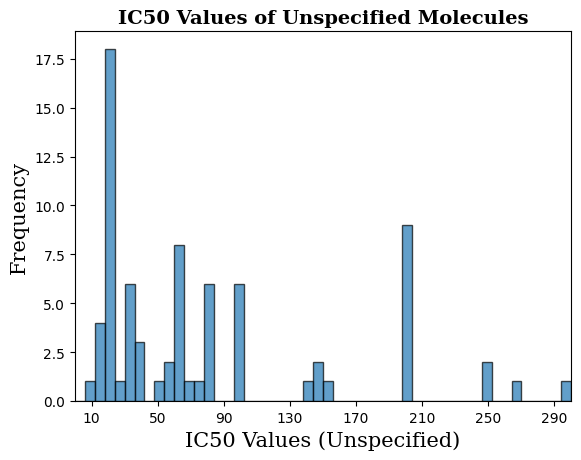

In [ ]:
ic50_values2 = df_unspecified_IC50_ranked['Value'].to_numpy()
plt.hist(ic50_values2, bins=50, edgecolor='black', alpha=0.7, range = (0, max(ic50_values2)))
plt.xlabel('IC50 Values (Unspecified)', fontdict={'fontsize': 15, 'family': 'serif'})
plt.ylabel('Frequency', fontdict={'fontsize': 15, 'family': 'serif'})
plt.title('IC50 Values of Unspecified Molecules', fontdict={'fontsize': 14, 'fontweight': 'bold', 'family': 'serif'})
plt.margins(x=0)
plt.xticks([10, 50, 90, 130, 170, 210, 250, 290])
plt.show()

The subsets can now be sliced to accomodate the ranges of IC50s we wish.

In [ ]:
df_active_IC50_ranked = df_active_IC50_ranked[df_active_IC50_ranked["Value"] < 0.6]
df_unspecified_IC50_ranked = df_unspecified_IC50_ranked[df_unspecified_IC50_ranked["Value"] < 301]
print(len(df_active_IC50_ranked))
print(len(df_unspecified_IC50_ranked))

216
75


Note that the dataset is much more balanced now as a result of our statistical search.

When experimenting with a two class classficiation mode, it is best that one class take about 50-70% of the dataset to prevent bias.

In [ ]:
df_active2 = df_active_IC50_ranked
df_inactive2 = df[df['Activity'] == "Inactive"]
df_unspecified2 = df_unspecified_IC50_ranked
print("Active: " + str(len(df_active2)))
print("Inactive: " + str(len(df_inactive2)+len(df_unspecified2)))

Active: 216
Inactive: 120


Now it is time to create a master dataset with all the molecules that we wish our model to learn off of. Concatenate the dataframes of the active, inactive, and unspecified molecules and drop all columns except the SMILES, Activity, and any identfication purposed column

In [ ]:
df2 = pd.concat([df_active2, df_inactive2, df_unspecified2], ignore_index = True)
selected_columns = ['CID','Compound_Name', 'Smiles', 'Activity']
df2 = df2[selected_columns]
activity_list = []
for activity in df2["Activity"]:
  if activity == "Active":
    activity_list.append(1)
  elif activity == "Inactive" or activity == "Unspecified" or activity == "Inconclusive":
    activity_list.append(0)
df2["Activity Value"] = activity_list
df2

,CID,Compound_Name,Smiles,Activity,Activity Value
0,73504704,(4-Methoxycarbonylphenyl)methyl 4-[2-[(2-bromo...,COC(=O)c1ccc(COC(=O)N2CCN(C(=O)CNC(=O)CBr)CC2)cc1,Active,1
1,73775396,N-[2-[4-(adamantane-1-carbonyl)piperazin-1-yl]...,O=C(CBr)NCC(=O)N1CCN(C(=O)C23CC4CC(CC(C4)C2)C3...,Active,1
2,73775533,N-[2-[4-[[5-(dimethylamino)-1-naphthyl]sulfony...,C=CC(=O)NCC(=O)N1CCN(S(=O)(=O)c2cccc3c(N(C)C)c...,Active,1
3,73775247,1-Adamantylmethyl 4-[2-[(2-bromoacetyl)amino]a...,O=C(CBr)NCC(=O)N1CCN(C(=O)OCC23CC4CC(CC(C4)C2)...,Active,1
4,73775246,(6-Methoxycarbonyl-2-naphthyl)methyl 4-[2-[(2-...,COC(=O)c1ccc2cc(COC(=O)N3CCN(C(=O)CNC(=O)CCl)C...,Active,1
...,...,...,...,...,...
331,72205083,(2S)-5-oxo-2-[[2-(phenylmethoxycarbonylamino)a...,Cc1c(C)[n+](C)c(SCC(=O)CCC(NC(=O)CNC(=O)OCc2cc...,Unspecified,0
332,7054,Isatin,O=C1Nc2ccccc2C1=O,Unspecified,0
333,3798517,"1-{4-[(2,3-Dioxo-2,3-dihydro-1H-indol-1-YL)met...",Cc1cc(CN2C(=O)C(=O)c3ccccc32)c(C)cc1CN1C(=O)C(...,Unspecified,0
334,6020915,(E)-3-(3-hydroxyphenyl)-1-pyridin-3-ylprop-2-e...,O=C(C=Cc1cccc(O)c1)c1cccnc1,Unspecified,0


## Step 2: Getting Molecular Fingerprints & Descriptors

2.1: Generate rdkit fingerprints to serve as features that our model will learn off of

Molecular fingerprints are binary variables that indicate the presence of a certain functional group or substructure in a molecule. Because the bioactivity of a drug primarily depends on its properties, fingerprints are an excellent tool to aid our model in predicting the activity of molecules it has never seen before

Generate a visualized structure for each molecule using its SMILES. This will be used to calculate the actual fingerprints.

In [ ]:
from rdkit.Chem import PandasTools
PandasTools.AddMoleculeColumnToFrame(df2,'Smiles', 'Structure')

,CID,Compound_Name,Smiles,Activity,Activity Value,Structure
0,73504704,(4-Methoxycarbonylphenyl)methyl 4-[2-[(2-bromo...,COC(=O)c1ccc(COC(=O)N2CCN(C(=O)CNC(=O)CBr)CC2)cc1,Active,1,
1,73775396,N-[2-[4-(adamantane-1-carbonyl)piperazin-1-yl]...,O=C(CBr)NCC(=O)N1CCN(C(=O)C23CC4CC(CC(C4)C2)C3...,Active,1,
2,73775533,N-[2-[4-[[5-(dimethylamino)-1-naphthyl]sulfony...,C=CC(=O)NCC(=O)N1CCN(S(=O)(=O)c2cccc3c(N(C)C)c...,Active,1,
3,73775247,1-Adamantylmethyl 4-[2-[(2-bromoacetyl)amino]a...,O=C(CBr)NCC(=O)N1CCN(C(=O)OCC23CC4CC(CC(C4)C2)...,Active,1,
4,73775246,(6-Methoxycarbonyl-2-naphthyl)methyl 4-[2-[(2-...,COC(=O)c1ccc2cc(COC(=O)N3CCN(C(=O)CNC(=O)CCl)C...,Active,1,
...,...,...,...,...,...,...
331,72205083,(2S)-5-oxo-2-[[2-(phenylmethoxycarbonylamino)a...,Cc1c(C)[n+](C)c(SCC(=O)CCC(NC(=O)CNC(=O)OCc2cc...,Unspecified,0,
332,7054,Isatin,O=C1Nc2ccccc2C1=O,Unspecified,0,
333,3798517,"1-{4-[(2,3-Dioxo-2,3-dihydro-1H-indol-1-YL)met...",Cc1cc(CN2C(=O)C(=O)c3ccccc32)c(C)cc1CN1C(=O)C(...,Unspecified,0,
334,6020915,(E)-3-(3-hydroxyphenyl)-1-pyridin-3-ylprop-2-e...,O=C(C=Cc1cccc(O)c1)c1cccnc1,Unspecified,0,

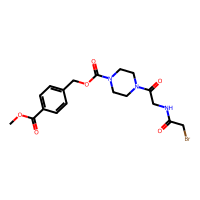
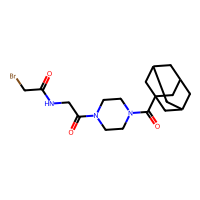
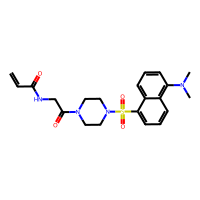
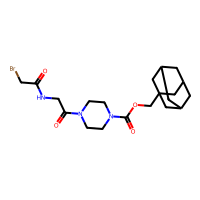
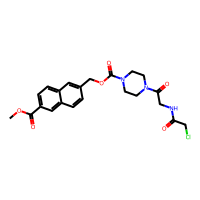
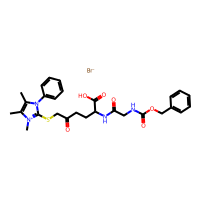
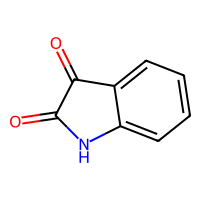
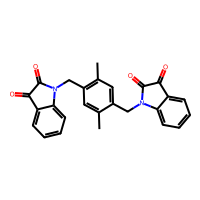
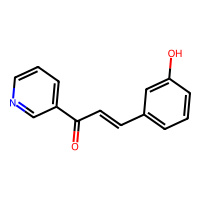
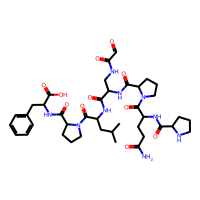

In [ ]:
df2

Import necessary fingerprint libaries and write a function that calculates all fingerprints and stores in a numpy array

In [ ]:
from rdkit.Chem.inchi import MolBlockToInchi
from rdkit.Chem import rdMolDescriptors
from rdkit.Chem import MACCSkeys
def generate_fpts(data):

    Rdk_fpts = []

    rdkbi_list= []

    onbit_list = []

    for smiles in data["Smiles"]:
        mol = Chem.MolFromSmiles(smiles)
        rdkbi = {}
        Rdk = AllChem.RDKFingerprint(mol, maxPath=5, fpSize=512, bitInfo=rdkbi)
        Rdk_fpts.append(Rdk)
        rdkbi_list.append(rdkbi)
        onbit_list.append(list(Rdk.GetOnBits())[:10])


    return pd.DataFrame(np.array(Rdk_fpts)), rdkbi_list, rdkbi, onbit_list

In [ ]:
df3, rdkbi_list, rdkbi, onbit_list = generate_fpts(df2)
df3 = pd.DataFrame(df3)
df3

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
0,0,1,1,0,0,0,0,0,1,1,...,0,0,0,0,1,1,1,0,0,1
1,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
2,0,0,1,1,1,0,0,0,0,0,...,0,0,0,0,1,0,1,0,1,1
3,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,1,0,1,0,0,1
4,0,1,1,0,0,0,0,0,1,1,...,0,0,0,0,1,1,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
331,1,0,1,1,0,1,1,1,1,1,...,0,1,0,0,1,1,1,1,1,1
332,0,1,1,0,1,1,0,1,0,1,...,0,0,0,0,1,1,1,0,0,1
333,0,1,1,0,1,1,0,1,0,1,...,0,0,0,1,1,1,1,0,0,1
334,1,1,1,1,0,1,0,0,0,1,...,0,0,0,1,1,0,1,0,0,1


Call the fingerprint generation function and convert to a dataframe

You will now be able to observe the binary values of the fingerprints. A "1" indicates the presence of a certain substructure while "0" indicates the absence

2.2: Remove correlated and low_variance fingerprint features

Although each fingerprint may represent a distinct substructure, the presence of a fingerprint may be dependent on the presence of another indicating that the dependent fingerprint is simply an unncessary extra parameter for our model to learn off of. These can be removed by writing a quick function that deletes highly correlated features.

That is not to say that correlation is not important when discussing bioactivity but the most important relationships in feature analysis are between INDEPENDENT features that are moderately related and contribute in combination with each other towards activity rather than directly affect each other.

Fingerprints can also be classified as "low variance" if its presence or absence is fairly prominent throughout the set indicating that it is not a distinguishable factor. These can also be removed.

In [ ]:
def remove_correlated_features(descriptors):

    correlated_matrix = descriptors.corr().abs()


    upper_triangle = correlated_matrix.where(np.triu(np.ones(correlated_matrix.shape),k=1).astype(bool))


    to_drop = [column for column in upper_triangle.columns if any(upper_triangle[column] >= 0.9)]
    descriptors_correlated_dropped = descriptors.drop(columns=to_drop, axis=1)
    return descriptors_correlated_dropped, to_drop

fingerprints_new, to_drop = remove_correlated_features(df3)
from sklearn.feature_selection import VarianceThreshold

def remove_low_variance(input_data, threshold=0.1):
    selection = VarianceThreshold(threshold)
    selection.fit(input_data)
    selected_indices = selection.get_support(indices=True)
    removed_indices = [i for i in range(input_data.shape[1]) if i not in selected_indices]
    return input_data[input_data.columns[selection.get_support(indices=True)]], removed_indices

df5, removed_indices = remove_low_variance(fingerprints_new, threshold=0.1)
df5

,0,1,4,5,6,7,8,9,10,11,...,499,500,501,502,503,504,505,507,509,510
0,0,1,0,0,0,0,1,1,0,0,...,1,0,1,0,0,0,0,1,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0,0,0,...,1,0,1,0,0,0,0,0,0,1
3,0,0,0,0,1,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,0,1,1,0,0,...,1,0,1,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
331,1,0,0,1,1,1,1,1,0,1,...,1,1,1,0,1,0,0,1,1,1
332,0,1,1,1,0,1,0,1,0,1,...,0,0,1,0,0,0,0,1,0,0
333,0,1,1,1,0,1,0,1,1,1,...,0,0,1,0,0,0,1,1,0,0
334,1,1,0,1,0,0,0,1,0,1,...,0,1,0,0,0,0,1,0,0,0


In [ ]:
all_drops = to_drop + removed_indices
all_drops

[330,
 342,
 2,
 3,
 16,
 36,
 40,
 51,
 64,
 81,
 87,
 103,
 112,
 117,
 141,
 142,
 161,
 166,
 186,
 194,
 209,
 233,
 236,
 238,
 248,
 265,
 280,
 284,
 290,
 294,
 297,
 312,
 341,
 351,
 369,
 371,
 372,
 379,
 386,
 402,
 403,
 410,
 416,
 417,
 428,
 439,
 443,
 447,
 460,
 479,
 480,
 491,
 504,
 506,
 509]

2.3: Get Molecular Desciptors for all molecules

In [ ]:
from rdkit.Chem import Descriptors
def getMolDescriptors(mol, missingVal=None):
    res = {}
    for nm,fn in Descriptors._descList:
        try:
            val = fn(mol)
        except:
            import traceback
            traceback.print_exc()
            val = missingVal
        res[nm] = val
    return res

mols_desc = [Chem.MolFromSmiles(molecule) for molecule in df2["Smiles"]]
allDescrs = [getMolDescriptors(molecule) for molecule in mols_desc]
print(allDescrs[0])
df10 = pd.DataFrame(allDescrs)
df10

{'MaxAbsEStateIndex': 12.187247039860226, 'MaxEStateIndex': 12.187247039860226, 'MinAbsEStateIndex': 0.059078166969260604, 'MinEStateIndex': -0.46135650746626555, 'qed': 0.5009871551522316, 'SPS': 13.642857142857142, 'MolWt': 456.2930000000002, 'HeavyAtomMolWt': 434.11700000000013, 'ExactMolWt': 455.069197524, 'NumValenceElectrons': 152, 'NumRadicalElectrons': 0, 'MaxPartialCharge': 0.40971665780762734, 'MinPartialCharge': -0.4654175212303123, 'MaxAbsPartialCharge': 0.4654175212303123, 'MinAbsPartialCharge': 0.40971665780762734, 'FpDensityMorgan1': 1.0357142857142858, 'FpDensityMorgan2': 1.6428571428571428, 'FpDensityMorgan3': 2.2142857142857144, 'BCUT2D_MWHI': 79.91872991762592, 'BCUT2D_MWLOW': 10.139163581336364, 'BCUT2D_CHGHI': 2.2464711944419657, 'BCUT2D_CHGLO': -2.3370933616243823, 'BCUT2D_LOGPHI': 2.0936473398296145, 'BCUT2D_LOGPLOW': -2.5230923998448294, 'BCUT2D_MRHI': 9.09156816604207, 'BCUT2D_MRLOW': -0.13328161934241156, 'AvgIpc': 2.7486081400064735, 'BalabanJ': 1.73556134618

,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
0,12.187247,12.187247,0.059078,-0.461357,0.500987,13.642857,456.293,434.117,455.069198,152,...,0,0,0,0,0,0,0,0,0,0
1,13.342388,13.342388,0.035077,-0.186130,0.691205,35.500000,426.355,398.131,425.131404,144,...,0,0,0,0,0,0,0,0,0,0
2,13.353565,13.353565,0.130716,-3.716049,0.691985,15.066667,430.530,404.322,430.167476,160,...,0,1,0,0,0,0,0,0,0,0
3,12.559640,12.559640,0.000893,-0.240337,0.642382,33.678571,456.381,426.141,455.141969,156,...,0,0,0,0,0,0,0,0,0,0
4,12.395315,12.395315,0.108263,-0.450298,0.518853,13.562500,461.902,437.710,461.135363,170,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
331,12.665429,12.665429,0.000000,-1.261695,0.176601,11.175000,633.565,600.301,632.130418,214,...,1,0,0,0,0,0,0,0,0,0
332,10.984491,10.984491,0.443889,-0.535926,0.552029,14.545455,147.133,142.093,147.032028,54,...,0,0,0,0,0,0,0,0,0,0
333,12.543963,12.543963,0.290183,-0.523044,0.597933,14.937500,424.456,404.296,424.142307,158,...,0,0,0,0,0,0,0,0,0,0
334,11.713616,11.713616,0.109775,-0.109775,0.645011,10.588235,225.247,214.159,225.078979,84,...,0,0,0,0,0,0,0,0,0,0


Concatenate fingerprints, descriptors and molecules and drop all columns that are not features or the class.

We now have our final dataset that we will train our classification models on!

In [ ]:
df4 = pd.concat([df5, df10, df2], axis=1)
# df4 = pd.concat([df3, df2], axis=1)
df4.drop(['Activity', 'Compound_Name', 'CID', 'Smiles', 'Structure'], axis = 1, inplace = True)
df4

,0,1,4,5,6,7,8,9,10,11,...,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea,Activity Value
0,0,1,0,0,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,1,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1
3,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
4,0,1,0,0,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
331,1,0,0,1,1,1,1,1,0,1,...,0,0,0,0,0,0,0,0,0,0
332,0,1,1,1,0,1,0,1,0,1,...,0,0,0,0,0,0,0,0,0,0
333,0,1,1,1,0,1,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
334,1,1,0,1,0,0,0,1,0,1,...,0,0,0,0,0,0,0,0,0,0


## Step 3: Training Classification Models on Dataset

3.1: Perform preliminary procedures for training

Split dataset into training and testing set, make sure to set stratify = y to keep ratio constant in training and testing sets

In [ ]:
X = df4.iloc[:, :-1].values
y = df4.iloc[:, -1].values


from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, stratify = y, random_state = 1) # stratify keeps ratio constant

In [ ]:
active_count1 = 0
for x in y_train:
  if x == 1:
    active_count1+=1
active_count2 = 0
for x in y_test:
  if x == 1:
    active_count2+=1
print(len(y_train))
print(len(y_test))
print(active_count1)
print(active_count2)
print(active_count1/len(y_train))
print(active_count2/len(y_test))

252
84
162
54
0.6428571428571429
0.6428571428571429


Perform feature scaling to prevent the dominance of a single feature

Note that if we only had fingerprints, feature scaling would not affect our dataset at the because it is completely binary but we do have descriptors which contain some values that are on a totally different scale from fingerprints. We will only standard scale descriptors.

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [ ]:
X_train[:1]

array([[-0.88014083, -1.46628783, -1.        , -1.34164079, -1.30754634,
        -0.6017991 ,  0.99209474,  0.38818157, -0.77787887,  1.0405021 ,
        -0.47254732,  1.41421356,  0.58345997,  0.75180941,  0.38138504,
        -0.73251987, -1.03226633, -0.92354815,  1.11803399, -0.54065487,
         0.52223297, -0.91619652, -0.93094934, -1.27475488,  0.45993311,
        -0.60791876, -0.44080925, -0.75828754, -0.44080925, -1.80864215,
         0.8660254 , -0.88014083,  0.56512983,  1.07417231,  0.65094455,
        -0.38138504,  0.36760731, -0.47881969,  1.45296631, -0.75828754,
        -0.5956834 ,  0.47254732,  1.50755672,  0.96874225,  0.67575691,
         0.60791876,  1.22272217, -0.64477154, -0.75180941, -0.70710678,
         1.1361818 , -0.63860882, -1.14539365,  1.17360917, -0.67575691,
         0.55290097, -0.8660254 , -0.6017991 , -0.35355339,  0.75180941,
        -0.66953406,  0.52223297, -0.82462113, -1.64495664, -0.80439967,
        -0.74535599, -0.68199434, -1.82888698,  0.8

3.2: Use lazypredict to find the best classification model for our dataset

Lazypredict is a package that can train tens of different models on our dataset and provide us the ones with the best performance scores

In [ ]:
!pip install lazypredict
import lazypredict
from lazypredict.Supervised import LazyClassifier
lcls = LazyClassifier(verbose=0, ignore_warnings=True, custom_metric=None)
models, prediction_tests = lcls.fit(X_train, X_test, y_train, y_test)
prediction_tests

 97%|█████████▋| 28/29 [00:04<00:00,  7.90it/s]

[LightGBM] [Info] Number of positive: 162, number of negative: 90
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004246 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7847
[LightGBM] [Info] Number of data points in the train set: 252, number of used features: 613
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.642857 -> initscore=0.587787
[LightGBM] [Info] Start training from score 0.587787
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

100%|██████████| 29/29 [00:05<00:00,  5.80it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
AdaBoostClassifier,0.96,0.96,0.96,0.96,0.52
XGBClassifier,0.95,0.95,0.95,0.95,0.30
LogisticRegression,0.95,0.94,0.94,0.95,0.11
ExtraTreesClassifier,0.94,0.94,0.94,0.94,0.20
LGBMClassifier,0.94,0.94,0.94,0.94,0.40
CalibratedClassifierCV,0.94,0.93,0.93,0.94,1.16
RandomForestClassifier,0.94,0.93,0.93,0.94,0.29
PassiveAggressiveClassifier,0.94,0.93,0.93,0.94,0.07
RidgeClassifierCV,0.94,0.92,0.92,0.94,0.15


Look at the top row of the printed table which will reveal the highest accuracy model for your dataset

RandomForestClassifier is the best model in our case.

Reproduce the results of the lazy classifier to verify its results

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
etc2 = AdaBoostClassifier()
etc2.fit(X_train, y_train)
etc_pred2 = etc2.predict(X_test)

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.dummy import DummyClassifier
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
etc_cm2 = confusion_matrix(y_test, etc_pred2)
print(etc_cm2)
accuracy_score(y_test, etc_pred2)

[[28  2]
 [ 1 53]]


0.9642857142857143

Run a Dummy Classifier to establish the baseline

In [ ]:
dcl = DummyClassifier()
dcl.fit(X_train, y_train)
dcl_pred = dcl.predict(X_test)

dcl_cm = confusion_matrix(y_test, dcl_pred)
print(dcl_cm)
accuracy_score(y_test, dcl_pred)

[[ 0 30]
 [ 0 54]]


0.6428571428571429

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_validate, StratifiedKFold
from sklearn.metrics import make_scorer, precision_score, recall_score, f1_score, accuracy_score, roc_auc_score
from sklearn.pipeline import make_pipeline

kf2 = StratifiedKFold(n_splits=5, shuffle=True)
model_pipeline2 = make_pipeline(StandardScaler(), etc2)

metrics_dict2 = {
    'Precision': make_scorer(precision_score),
    'Recall': make_scorer(recall_score),
    'F1 Score': make_scorer(f1_score),
    'Accuracy': make_scorer(accuracy_score),
    'AUC-ROC': make_scorer(roc_auc_score)
}

all_trials_scores2 = {metric: [] for metric in metrics_dict2}

for i in range(100):
    scores2 = cross_validate(model_pipeline2, X, y, cv=kf2, scoring=metrics_dict2)

    for metric in metrics_dict2:
        all_trials_scores2[metric].append(scores2[f'test_{metric}'].mean())
        print(scores2[f'test_{metric}'].mean())

0.895800185013876
0.9536997885835096
0.9237373737373737
0.8987708516242318
0.8768498942917548
0.8825892554650319
0.9676532769556025
0.9226891628488041
0.8958735733099209
0.8671599718111347
0.8924671560323734
0.9214587737843551
0.9056536064640405
0.8749780509218613
0.8565627202255108
0.9154580981328702
0.9675475687103594
0.9397458955531721
0.9197102721685688
0.9004404510218462
0.9001409629531739
0.9445031712473574
0.9214755634319415
0.8959174714661984
0.8764182522903454
0.9051775798559569
0.9631078224101479
0.9327170913377809
0.910667251975417
0.8898872445384074
0.8883903846830676
0.9401691331923889
0.9121046894182717
0.8839771729587358
0.8617512332628612
0.8819818951866761
0.9257928118393235
0.9014782647706058
0.8689201053555751
0.8462297392529949
0.9007632117522982
0.9582452431289641
0.9282927141386981
0.9047848990342405
0.8832892882311485
0.9073467908902693
0.9677589852008456
0.9355368270504357
0.9136084284460052
0.8922128259337562
0.9035041407867495
0.9446088794926004
0.923146536213

In [ ]:
average_scores2 = {metric: np.mean(all_trials_scores2[metric]) for metric in metrics_dict2}
average_scores2

{'Precision': 0.9018857133542864,
 'Recall': 0.9479207188160675,
 'F1 Score': 0.9236669946092735,
 'Accuracy': 0.8991044776119402,
 'AUC-ROC': 0.8795853594080341}

In [ ]:
!pip install optuna
import optuna
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler



def objective(trial):

    n_estimators = trial.suggest_int('n_estimators', 50, 200)
    learning_rate = trial.suggest_loguniform('learning_rate', 0.01, 1.0)



    model = AdaBoostClassifier(n_estimators=n_estimators, learning_rate=learning_rate, random_state=42)

    model.fit(X_train, y_train)


    y_pred = model.predict(X_test)


    accuracy = accuracy_score(y_test, y_pred)

    return accuracy


study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)


best_params = study.best_params
print("Best Hyperparameters:", best_params)

best_n_estimators = best_params['n_estimators']
best_learning_rate = best_params['learning_rate']


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 413.4/413.4 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.4/233.4 kB 16.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 7.8 MB/s eta 0:00:00


[I 2024-02-10 17:15:22,966] A new study created in memory with name: no-name-aaa6d960-8775-4b6f-9aa1-8c111549d1b0
[I 2024-02-10 17:15:23,491] Trial 0 finished with value: 0.8571428571428571 and parameters: {'n_estimators': 81, 'learning_rate': 0.012707150512572402}. Best is trial 0 with value: 0.8571428571428571.
[I 2024-02-10 17:15:24,698] Trial 1 finished with value: 0.9404761904761905 and parameters: {'n_estimators': 193, 'learning_rate': 0.014473242906771882}. Best is trial 1 with value: 0.9404761904761905.
[I 2024-02-10 17:15:25,873] Trial 2 finished with value: 0.9047619047619048 and parameters: {'n_estimators': 187, 'learning_rate': 0.013737626739163403}. Best is trial 1 with value: 0.9404761904761905.
[I 2024-02-10 17:15:26,321] Trial 3 finished with value: 0.9523809523809523 and parameters: {'n_estimators': 72, 'learning_rate': 0.5352956274640057}. Best is trial 3 with value: 0.9523809523809523.
[I 2024-02-10 17:15:26,763] Trial 4 finished with value: 0.8928571428571429 and pa

Best Hyperparameters: {'n_estimators': 104, 'learning_rate': 0.299335515207599}


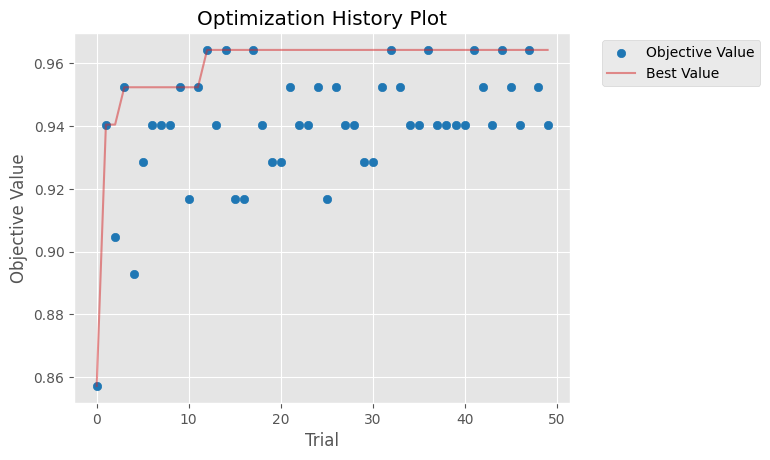

In [ ]:
optuna.visualization.matplotlib.plot_optimization_history(study)
plt.show()

[W 2024-02-10 17:15:58,175] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


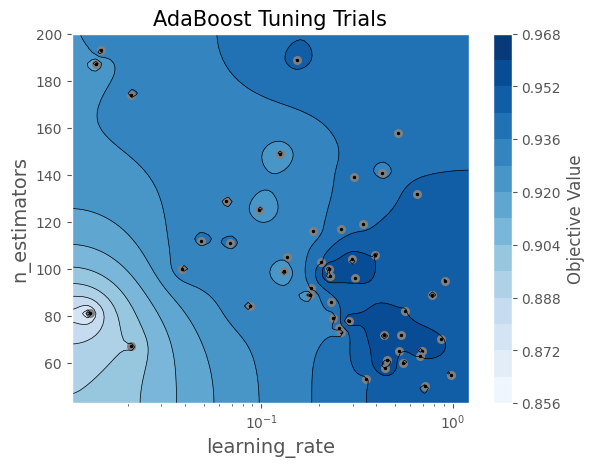

In [ ]:
ax = optuna.visualization.matplotlib.plot_contour(study, params=["n_estimators", "learning_rate"])
ax.set_xlabel('learning_rate', fontsize=14)
ax.set_ylabel('n_estimators', fontsize=14)
ax.set_title('AdaBoost Tuning Trials', fontsize=15)
plt.show()

In [ ]:
etc = AdaBoostClassifier(n_estimators = best_n_estimators,learning_rate =  best_learning_rate)
etc.fit(X_train, y_train)
etc_pred = etc.predict(X_test)
etc_cm = confusion_matrix(y_test, etc_pred)
print(etc_cm)
accuracy_score(y_test, etc_pred)

[[28  2]
 [ 1 53]]


0.9642857142857143

In [ ]:
import pickle
pickle.dump(etc , open('adaboost-model.pk1' , 'wb'))

In [ ]:
import sklearn
print(sklearn.__version__)

1.2.2


Create a confusion matrix to analyze the accuracy of your model

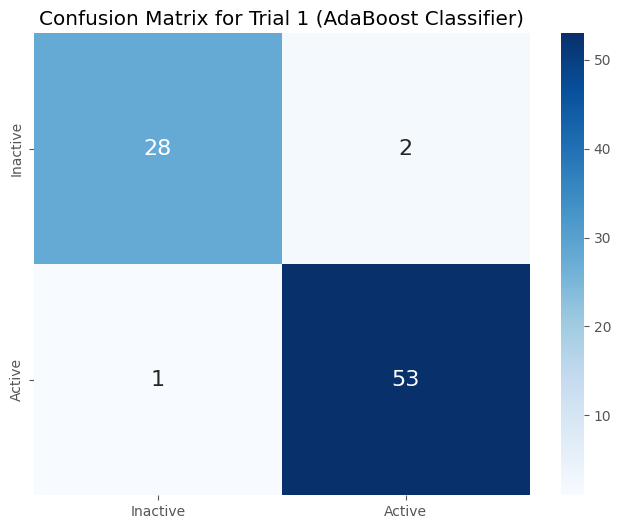

In [ ]:
import seaborn as sn
plt.figure(figsize=(8, 6))
sn.heatmap(etc_cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16},
            xticklabels=["Inactive", "Active"],
            yticklabels=["Inactive", "Active"])
plt.title("Confusion Matrix for Trial 1 (AdaBoost Classifier)")
plt.show()

The matrix tells us that our model accurately predicted the activity accurately of 96-97% of the molecules in our dataset.

Overall the accuracy level indicates a good performance of a RandomForest model on our dataset. One thing to analyze in the confusion matrix when performing computational drug discovery is the category of the errors.

Does the lion's share of your model's incorrect predictions compose of molecules which are active but your model predicted to be inactive or vice versa? This will give you an idea of whether your model is biased which may call for better analysis of IC50 values in Step 1.

3.3: Perform cross validation to obtain an average accuracy for the model

We must now evluate the overall reliability of our model by trying out new combinations of training and testing sets from our original dataset. Sklearn's KFold cross validation is a great tool to do this.

To ensure that every split has the same active to inactive ratio, we perform a Stratrified KFold with 5 splits.

We can do this a number of times (we did 10) and obtain an average, maximum, and minimum accuracy.

In [ ]:


kf = StratifiedKFold(n_splits=5, shuffle=True)
model_pipeline = make_pipeline(StandardScaler(), etc)

metrics_dict = {
    'Precision': make_scorer(precision_score),
    'Recall': make_scorer(recall_score),
    'F1 Score': make_scorer(f1_score),
    'Accuracy': make_scorer(accuracy_score),
    'AUC-ROC': make_scorer(roc_auc_score)
}

all_trials_scores = {metric: [] for metric in metrics_dict}

for i in range(100):
    scores = cross_validate(model_pipeline, X, y, cv=kf, scoring=metrics_dict)

    for metric in metrics_dict:
        all_trials_scores[metric].append(scores[f'test_{metric}'].mean())
        print(scores[f'test_{metric}'].mean())


0.9168917668825163
0.9676532769556025
0.9414686187719896
0.9226075504828797
0.9046599718111346
0.9107894642485783
0.9443974630021141
0.9270792181427143
0.9047848990342405
0.8888653981677239
0.9088367829401264
0.9582452431289641
0.9324150422632396
0.9107550482879718
0.8916226215644819
0.899113475177305
0.9677589852008456
0.9312550880194964
0.9076382791922739
0.8838794926004228
0.8980966475385082
0.9536997885835096
0.9243366441470012
0.8989464442493416
0.8768498942917548
0.897068950373298
0.9538054968287526
0.92400573330258
0.8987708516242318
0.8769027484143763
0.9210808252479401
0.9583509513742072
0.9390482826699185
0.9196663740122915
0.9041754756871037
0.9027184568218003
0.9630021141649049
0.9311175721437195
0.9078577699736611
0.8856677237491191
0.9138930322522605
0.9627906976744185
0.937165433446892
0.916681299385426
0.8980620155038759
0.9237426065808865
0.9723044397463003
0.9464952843626767
0.9286215978928885
0.91115221987315
0.9001879257693212
0.9492600422832981
0.9235583088839894
0

In [ ]:
average_scores = {metric: np.mean(all_trials_scores[metric]) for metric in metrics_dict}
average_scores

{'Precision': 0.9064306809162623,
 'Recall': 0.9569524312896407,
 'F1 Score': 0.9304035554116694,
 'Accuracy': 0.9077374890254609,
 'AUC-ROC': 0.8880595489781536}

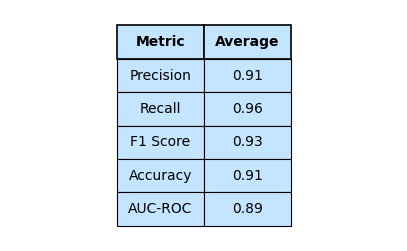

In [ ]:
fig, ax = plt.subplots(figsize=(5, 3))

table_data = [[key, f'{value:.2f}'] for key, value in average_scores.items()]

table = ax.table(cellText=table_data,colLabels=["Metric", "Average"], loc='center', cellLoc='center', colColours=['#c4e5ff']*2)

table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(0.45, 2)

for key, cell in table.get_celld().items():
    if key[0] == 0:
        cell.set_linewidth(1.2)
        cell.set_edgecolor('black')
        cell.set_text_props(weight='bold')
    else:
        cell.set_linewidth(0.8)
        cell.set_edgecolor('black')
    cell.set_facecolor('#c4e5ff')

ax.axis('off')
plt.show()

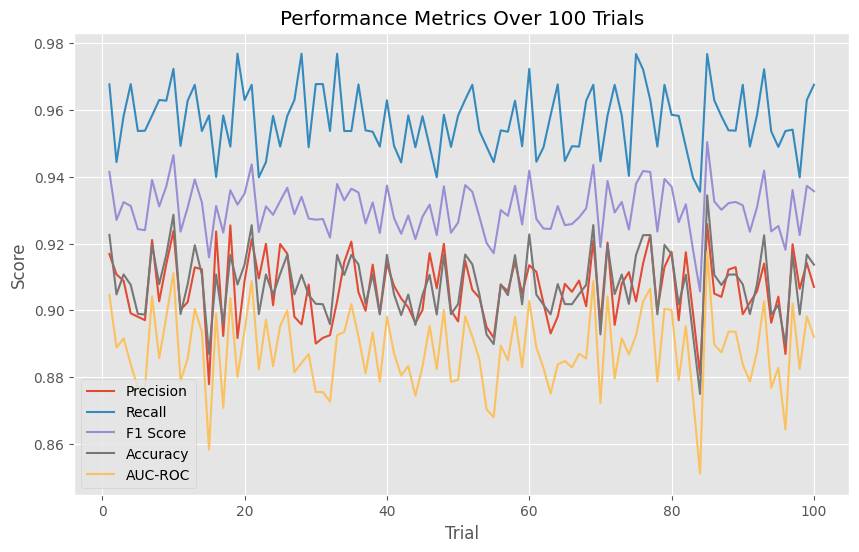

In [ ]:
plt.figure(figsize=(10, 6))
for metric in metrics_dict:
    sn.lineplot(x=range(1, 101), y=all_trials_scores[metric], label=metric)

plt.title('Performance Metrics Over 100 Trials')
plt.xlabel('Trial')
plt.ylabel('Score')
plt.legend()
plt.show()

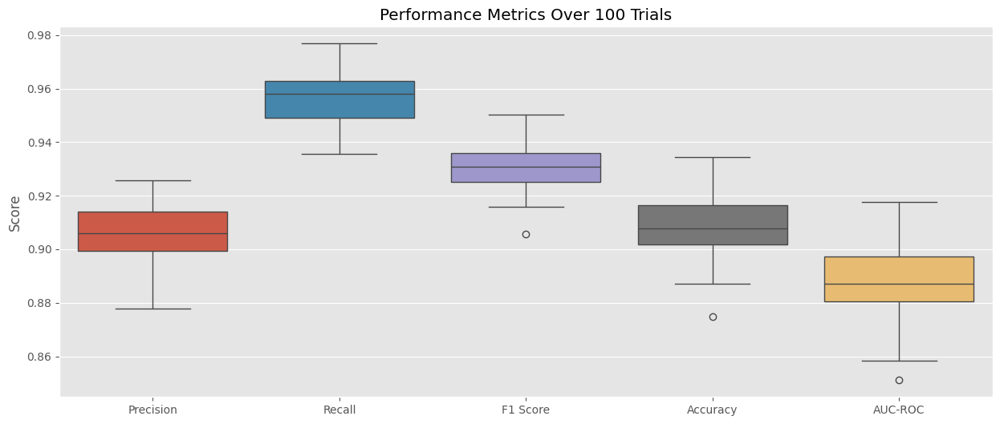

<Figure size 1500x600 with 0 Axes>

In [ ]:
plt.figure(figsize=(15, 6))
ax = sn.boxplot(data=pd.DataFrame(all_trials_scores))

for i, metric in enumerate(metrics_dict.keys()):
    avg_score = average_scores[metric]

plt.title('Performance Metrics Over 100 Trials')
plt.ylabel('Score')

plt.figure(figsize=(15, 6))
plt.show()

It seems that our model has an average accuracy of about 90-91%.

It is important to check whether this is reasonably close to the accuracy we obtained from the one split trained lazy classifier.

We can also perform a sample prediction using our model. The model must be fed with a smiles input to do this. We can see that the sample active molecule from our dataset below is predicted to be active (1) by our model.

In [ ]:
a_sample_smiles = "COC(=O)C1=CC=C(C=C1)COC(=O)N2CCN(CC2)C(=O)CNC(=O)CBr"
mol_samp = Chem.MolFromSmiles(a_sample_smiles)
canon_smiles = Chem.MolToSmiles(mol_samp)
mol = Chem.MolFromSmiles(canon_smiles)

rdkbi_input = {}
fingerprints_input = pd.DataFrame(np.array(AllChem.RDKFingerprint(mol_samp, maxPath=5, fpSize=512, bitInfo=rdkbi_input)))
fingerprints_input.drop(all_drops, inplace = True)
descriptors_input = getMolDescriptors(mol_samp)
desc_df = pd.DataFrame({'Values': pd.Series(list(descriptors_input.values()))})
desc_input = np.array(desc_df)
fing_input = np.array(fingerprints_input)
desc_input = desc_input.reshape((1, 210))
fing_input = fing_input.reshape(1, 457)
features = np.concatenate([fing_input, desc_input], axis=1)
features = sc.transform(features)
prediction = etc.predict(features)
print(prediction)

[1]


## Step 4: Feature Importance Analysis

4.1: Choose the feature importance model and look for common substructures

An important part of drug design is identifying certain substructures or functional groups that could be responsile for a molecule's bioactivity against a target.

If you remember, the parameters we used to train the model were molecular fingerprints which are binary values that indicate the presence of a certain type of component of a molecule (1 being present, 0 being not present)

Some classifiers have the capability of being able to identify the most important features that exert the highest influence on the classification of a datapoint. This is called feature importance.

Unforunately, our best classifier, AdaBoostClassifier does not have the capability to conduct feature importance. However, one classifier that also performed quite well was the Random Forest Classifier and it is an excellent model for feature importance extraction. Not all classifiers have the feature importance attribute so you will need to choose the best performing model from the lazy classifier that is compatible.

In [ ]:
from sklearn.ensemble import RandomForestClassifier
clf = RandomForestClassifier(random_state = 0)
clf.fit(X, y)
feature_importance = clf.feature_importances_
feature_names = list(df5.columns)
print(len(feature_importance))
feature_importance

667


array([6.26515980e-04, 4.62849724e-03, 0.00000000e+00, 2.38003376e-05,
       4.37716045e-04, 1.92512666e-03, 2.82012263e-04, 0.00000000e+00,
       9.76285961e-05, 1.82254026e-04, 6.43480925e-05, 3.34904108e-03,
       2.31885606e-03, 2.95033487e-03, 2.16996534e-04, 0.00000000e+00,
       1.41500857e-03, 3.84921560e-04, 5.96082554e-04, 5.35855678e-04,
       1.06024802e-03, 4.37537549e-04, 1.66233766e-04, 1.21874264e-03,
       2.44201315e-04, 0.00000000e+00, 2.27671644e-03, 2.41861878e-04,
       3.53223693e-04, 4.66502159e-03, 4.07224144e-04, 0.00000000e+00,
       4.61251130e-04, 9.49152542e-05, 3.93396558e-05, 0.00000000e+00,
       5.73721882e-04, 1.13313448e-03, 1.17184088e-03, 0.00000000e+00,
       4.65795789e-04, 2.25723950e-04, 3.16467619e-05, 6.73178197e-04,
       3.09677419e-04, 9.84166167e-04, 9.30988621e-05, 2.59909393e-03,
       2.14348093e-04, 8.82166488e-04, 2.47613854e-04, 7.37117020e-04,
       2.22689494e-04, 6.20039835e-04, 6.00153513e-04, 3.03271862e-04,
      

We can print the 10 index numbers with the highest importance overall, the 10 indices of highest fingerprints, and the 10 indices of highest descriptors.

In [ ]:
indices_descending_all = np.argsort(feature_importance)[::-1]
indices_descending_fing = np.argsort(feature_importance[:458])[::-1]
indices_descending_desc = np.argsort(feature_importance[458:667])[::-1]
top_indices_all = indices_descending_all[:10]
top_indices_fing = indices_descending_fing[:10]
top_indices_desc = indices_descending_desc[:10]
top_indices_desc = [(x+458) for x in top_indices_desc]
print("Highest Overall Features: " + str(top_indices_all))
print("Highest Fingerprints: " + str(top_indices_fing))
print("Highest Descriptors: " + str(top_indices_desc))

Highest Overall Features: [577 578 443 524 555 388 477 532 344 478]
Highest Fingerprints: [443 388 344 307 317 176  67 375 240 279]
Highest Descriptors: [577, 578, 524, 555, 477, 532, 478, 507, 481, 516]


To find top fingerprints, we must find the fingerprint numbers associated with each important indice. Below we can see that indice 443 corresponds to fingerprint 495. This is because we removed non-correlated fingerprints.

In [ ]:
important_fing_nums = [df4.columns[x] for x in top_indices_fing]
important_fing_nums

[495, 433, 382, 338, 350, 193, 74, 417, 263, 308]

4.2: Analyze the fingerprints of highest importance in our molecules

We can start out by simply visualizing the full structures of our molecules.

This will simply allow us to look for expected similarities. When working with much smaller molecules this would be much easier but because ours are much more complex, we will need to zoom into these molecules and find those fingerprints.

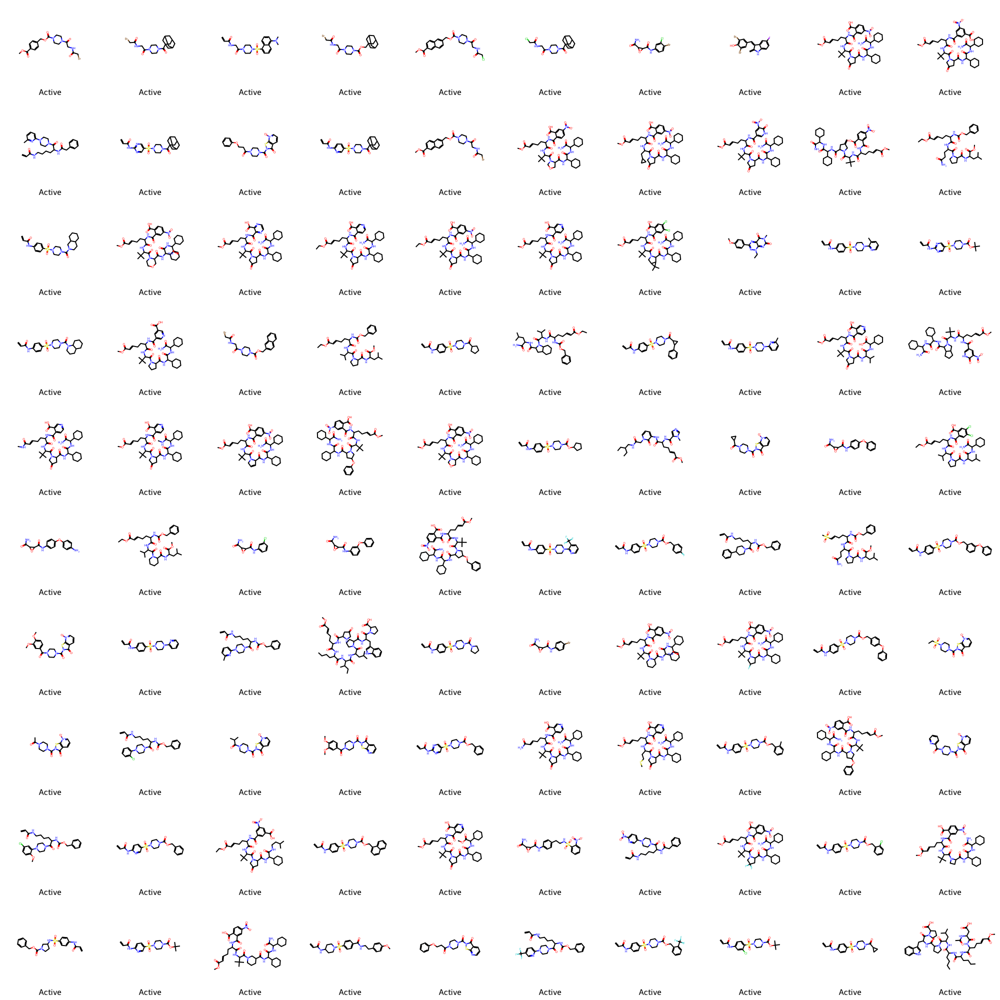

In [ ]:
from rdkit.Chem import Draw
Draw.MolsToGridImage([x for x in df2["Structure"][:336]], maxMols=100,
                     legends=[str(x) for x in df2.Activity[:336]], subImgSize=(200,200), molsPerRow=10)

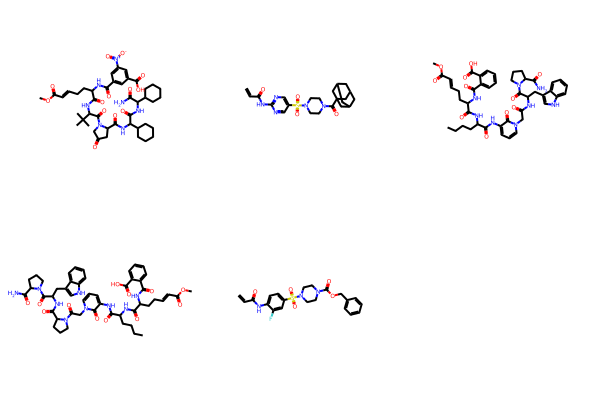

In [ ]:
Draw.MolsToGridImage(df2["Structure"][[9, 11, 259, 260, 262]])

When we generated fingerprints in Section 2.1, our function also gave us something called rdkbi which is known as the bit info. This is essentially a dictionary of all the molecules and there "on" bits (present fingerprints).

This info can be used to construct the substructures associated with a certain feature.

Below, we are printing the substructures of molecules with fingerprint 74.

By simply scrolling through the image grid above, we can definitely see a lot of similar substructures.

Our job is to decide on the following:
  
  Are these substructures common and significant enough in TG2 inhibitors to be considered a driving factor in bioactivity?

  Are these substructures just simply prevalent occurences in drug-like molecules and not necessarily specific to TG2 activity?

  Do some inactive molecules have the same substructures of active molecules?

  What chemical properties are these substructures responsible for and are these properties relevant to inhibition of the target?

  **Most important: Are these substructures indicative of activity or inactivity (Generally, if a substructure is more prevalent among actives than inactives, it has the potential of being a driving factor of activity)

Answering these questions will allow you to determine whether these substructures are good candidates for molecule generation and the next possible stage of you computational drug design journey, optimization.

We should also create a dictionary that will be used to create a bar graph on the number of active/inactive molecules for each particular fingerprint.

It would be useful to have sample substructures from each fingerprint to examine.

In [ ]:
fbg = {}

Actives with FP present: 180
Actives with FP not present: 37
Inactives with FP present: 31
Inactives with FP not present: 88


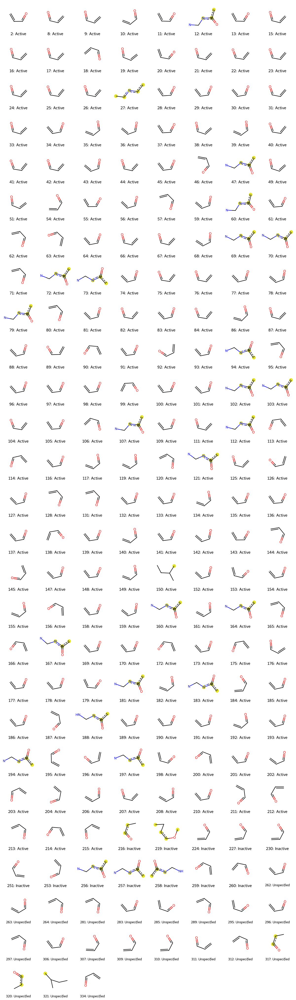

In [ ]:
fragments = []
legends = []
actives_present = 0
actives_not_present = 0
inactives_present = 0
inactives_not_present = 0
for x in range(0, 217):
  if 495 in rdkbi_list[x]:
    actives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 495, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    actives_not_present +=1

for x in range(217, 336):
  if 495 in rdkbi_list[x]:
    inactives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 495, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    inactives_not_present +=1

fbg["495"] = [actives_present, inactives_present]

print("Actives with FP present: " + str(actives_present))
print("Actives with FP not present: " + str(actives_not_present))
print("Inactives with FP present: " + str(inactives_present))
print("Inactives with FP not present: " + str(inactives_not_present))

img = Draw.DrawRDKitBits(fragments, molsPerRow=8, legends=legends)
img

Look at the diagram and try to find the substructure that is the most prominent. If we look at the picture above, we can clearly see that one type is particularly common. Add a sample of that substructure to the list "samples" and add the fingerprint number to the legend. If there is more than 1 substructure that is quite prominent, just add them as well!

Don't worry if you think you may have chosen the wrong substructures given how large the diagrams may be. We will confirm whether your predictions are correct later on!

In [ ]:
samples = []
samples_legend = []

rdkbi2 = rdkbi_list[9]
samples.append((df2.Structure[9], 495, rdkbi2))
samples_legend.append("495.1")
rdkbi2 = rdkbi_list[107]
samples.append((df2.Structure[107], 495, rdkbi2))
samples_legend.append("495.2")

Generate substructures for the most important features. Try to pick at least 5 to analyze.

Make sure to store one substructure from each fingerprint in the samples list (it should be the one that appears the most)

Actives with FP present: 29
Actives with FP not present: 188
Inactives with FP present: 71
Inactives with FP not present: 48


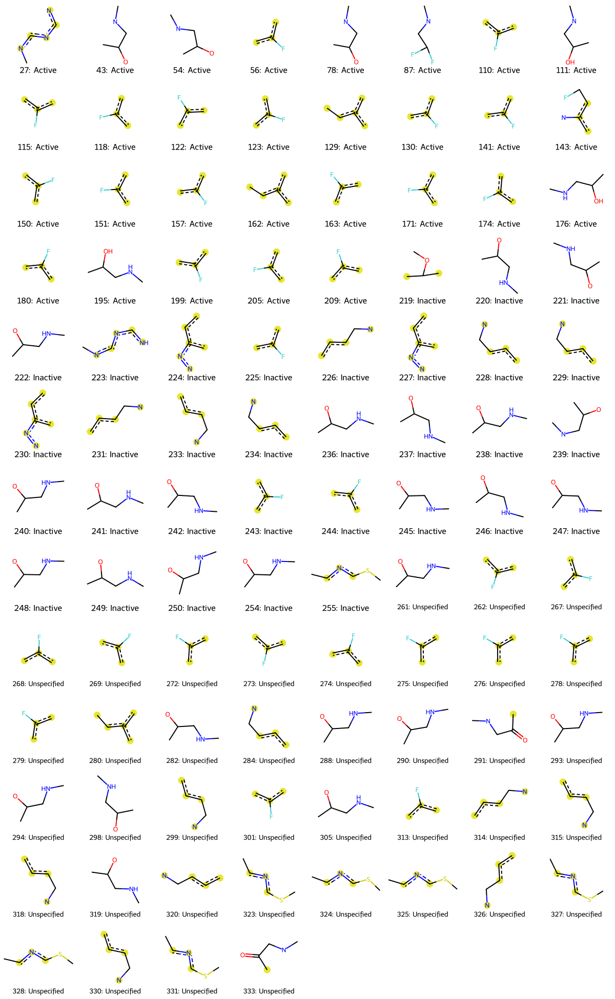

In [ ]:
fragments = []
legends = []
actives_present = 0
actives_not_present = 0
inactives_present = 0
inactives_not_present = 0
for x in range(0, 217):
  if 433 in rdkbi_list[x]:
    actives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 433, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    actives_not_present +=1

for x in range(217, 336):
  if 433 in rdkbi_list[x]:
    inactives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 433, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    inactives_not_present +=1

fbg["433"] = [actives_present, inactives_present]

print("Actives with FP present: " + str(actives_present))
print("Actives with FP not present: " + str(actives_not_present))
print("Inactives with FP present: " + str(inactives_present))
print("Inactives with FP not present: " + str(inactives_not_present))

img = Draw.DrawRDKitBits(fragments, molsPerRow=8, legends=legends)
img

In [ ]:
rdkbi2 = rdkbi_list[115]
samples.append((df2.Structure[115], 433, rdkbi2))
samples_legend.append("433.1")
rdkbi2 = rdkbi_list[245]
samples.append((df2.Structure[245], 433, rdkbi2))
samples_legend.append("433.2")

Actives with FP present: 193
Actives with FP not present: 24
Inactives with FP present: 51
Inactives with FP not present: 68


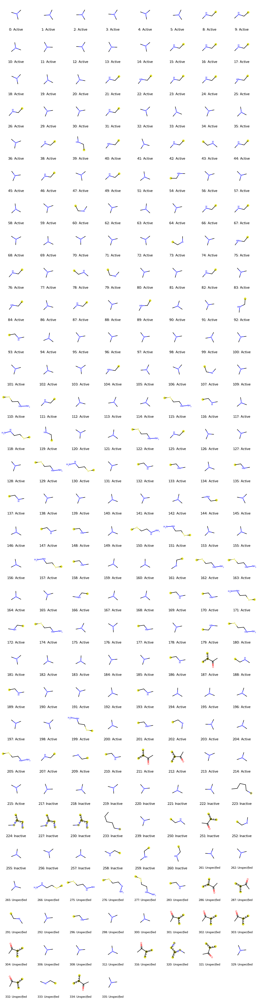

In [ ]:
fragments = []
legends = []
actives_present = 0
actives_not_present = 0
inactives_present = 0
inactives_not_present = 0
for x in range(0, 217):
  if 382 in rdkbi_list[x]:
    actives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 382, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    actives_not_present +=1

for x in range(217, 336):
  if 382 in rdkbi_list[x]:
    inactives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 382, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    inactives_not_present +=1

fbg["382"] = [actives_present, inactives_present]

print("Actives with FP present: " + str(actives_present))
print("Actives with FP not present: " + str(actives_not_present))
print("Inactives with FP present: " + str(inactives_present))
print("Inactives with FP not present: " + str(inactives_not_present))

img = Draw.DrawRDKitBits(fragments, molsPerRow=8, legends=legends)
img

In [ ]:
rdkbi2 = rdkbi_list[1]
samples.append((df2.Structure[1], 382, rdkbi2))
samples_legend.append("382.1")
rdkbi2 = rdkbi_list[166]
samples.append((df2.Structure[166], 382, rdkbi2))
samples_legend.append("382.2")

Actives with FP present: 46
Actives with FP not present: 171
Inactives with FP present: 89
Inactives with FP not present: 30


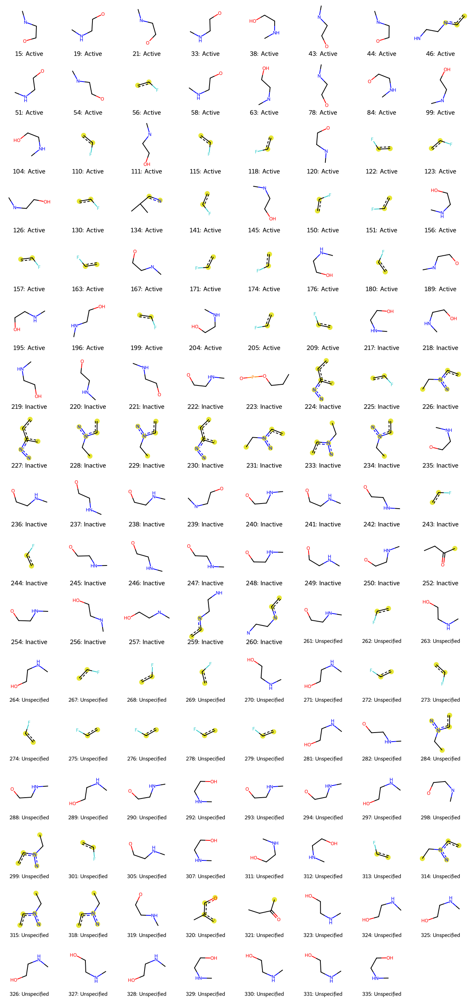

In [ ]:
fragments = []
legends = []
actives_present = 0
actives_not_present = 0
inactives_present = 0
inactives_not_present = 0
for x in range(0, 217):
  if 338 in rdkbi_list[x]:
    actives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 338, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    actives_not_present +=1

for x in range(217, 336):
  if 338 in rdkbi_list[x]:
    inactives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 338, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    inactives_not_present +=1

fbg["338"] = [actives_present, inactives_present]

print("Actives with FP present: " + str(actives_present))
print("Actives with FP not present: " + str(actives_not_present))
print("Inactives with FP present: " + str(inactives_present))
print("Inactives with FP not present: " + str(inactives_not_present))

img = Draw.DrawRDKitBits(fragments, molsPerRow=8, legends=legends)
img

In [ ]:
rdkbi2 = rdkbi_list[43]
samples.append((df2.Structure[43], 338, rdkbi2))
samples_legend.append("338.1")
rdkbi2 = rdkbi_list[118]
samples.append((df2.Structure[118], 338, rdkbi2))
samples_legend.append("338.2")
rdkbi2 = rdkbi_list[156]
samples.append((df2.Structure[156], 338, rdkbi2))
samples_legend.append("338.3")
rdkbi2 = rdkbi_list[224]
samples.append((df2.Structure[224], 338, rdkbi2))
samples_legend.append("338.4")

Actives with FP present: 41
Actives with FP not present: 176
Inactives with FP present: 76
Inactives with FP not present: 43


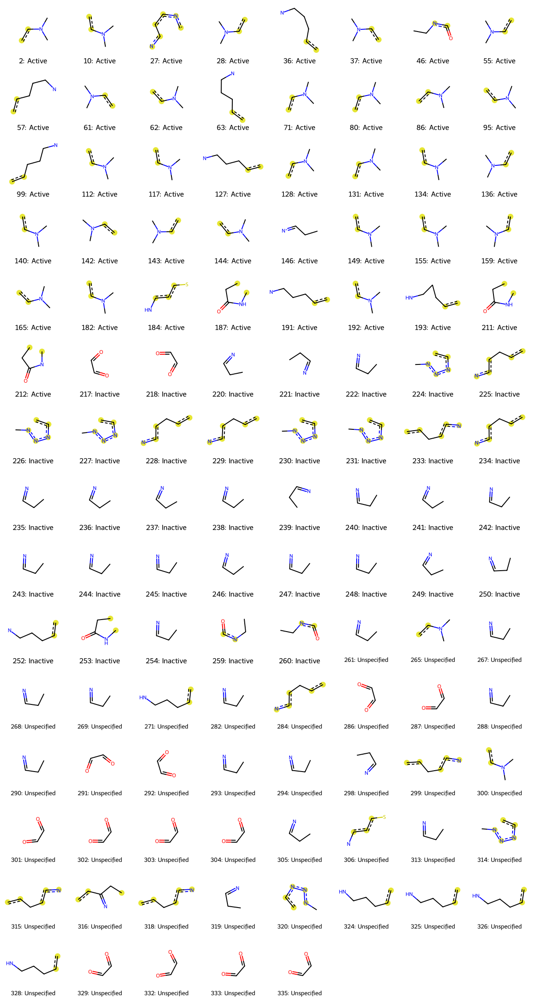

In [ ]:
fragments = []
legends = []
actives_present = 0
actives_not_present = 0
inactives_present = 0
inactives_not_present = 0
for x in range(0, 217):
  if 350 in rdkbi_list[x]:
    actives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 350, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    actives_not_present +=1

for x in range(217, 336):
  if 350 in rdkbi_list[x]:
    inactives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 350, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    inactives_not_present +=1

fbg["350"] = [actives_present, inactives_present]

print("Actives with FP present: " + str(actives_present))
print("Actives with FP not present: " + str(actives_not_present))
print("Inactives with FP present: " + str(inactives_present))
print("Inactives with FP not present: " + str(inactives_not_present))

img = Draw.DrawRDKitBits(fragments, molsPerRow=8, legends=legends)
img

In [ ]:
rdkbi2 = rdkbi_list[71]
samples.append((df2.Structure[71], 350, rdkbi2))
samples_legend.append("350.1")
rdkbi2 = rdkbi_list[246]
samples.append((df2.Structure[246], 350, rdkbi2))
samples_legend.append("350.2")

Actives with FP present: 144
Actives with FP not present: 73
Inactives with FP present: 17
Inactives with FP not present: 102


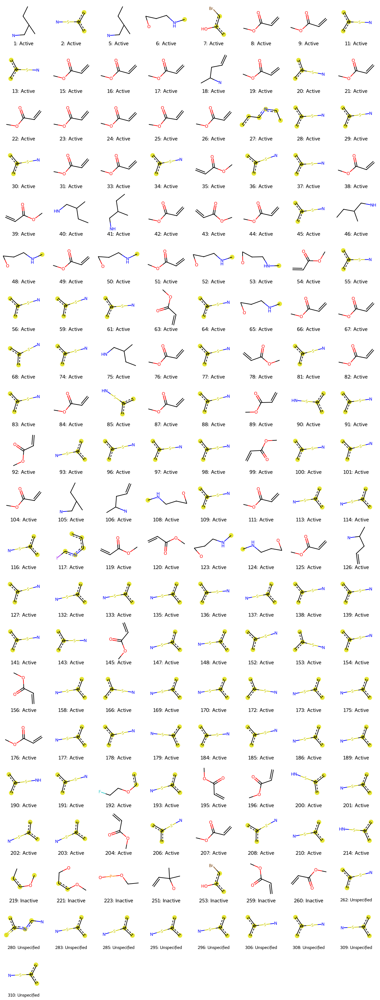

In [ ]:
fragments = []
legends = []
actives_present = 0
actives_not_present = 0
inactives_present = 0
inactives_not_present = 0
for x in range(0, 217):
  if 193 in rdkbi_list[x]:
    actives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 193, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    actives_not_present +=1

for x in range(217, 336):
  if 193 in rdkbi_list[x]:
    inactives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 193, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    inactives_not_present +=1

fbg["193"] = [actives_present, inactives_present]

print("Actives with FP present: " + str(actives_present))
print("Actives with FP not present: " + str(actives_not_present))
print("Inactives with FP present: " + str(inactives_present))
print("Inactives with FP not present: " + str(inactives_not_present))

img = Draw.DrawRDKitBits(fragments, molsPerRow=8, legends=legends)
img

In [ ]:
rdkbi2 = rdkbi_list[16]
samples.append((df2.Structure[16], 193, rdkbi2))
samples_legend.append("193.1")
rdkbi2 = rdkbi_list[36]
samples.append((df2.Structure[36], 193, rdkbi2))
samples_legend.append("193.2")
rdkbi2 = rdkbi_list[185]

Actives with FP present: 205
Actives with FP not present: 12
Inactives with FP present: 55
Inactives with FP not present: 64


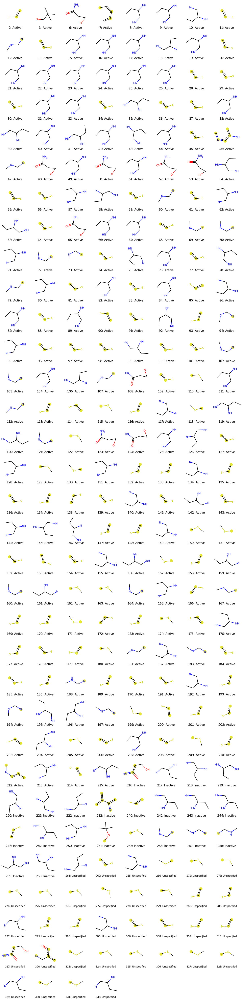

In [ ]:
fragments = []
legends = []
actives_present = 0
actives_not_present = 0
inactives_present = 0
inactives_not_present = 0
for x in range(0, 217):
  if 74 in rdkbi_list[x]:
    actives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 74, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    actives_not_present +=1

for x in range(217, 336):
  if 74 in rdkbi_list[x]:
    inactives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 74, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    inactives_not_present +=1

fbg["74"] = [actives_present, inactives_present]

print("Actives with FP present: " + str(actives_present))
print("Actives with FP not present: " + str(actives_not_present))
print("Inactives with FP present: " + str(inactives_present))
print("Inactives with FP not present: " + str(inactives_not_present))

img = Draw.DrawRDKitBits(fragments, molsPerRow=8, legends=legends)
img

In [ ]:
rdkbi2 = rdkbi_list[15]
samples.append((df2.Structure[15], 74, rdkbi2))
samples_legend.append("74.1")
rdkbi2 = rdkbi_list[45]
samples.append((df2.Structure[45], 74, rdkbi2))
samples_legend.append("74.2")

Actives with FP present: 113
Actives with FP not present: 104
Inactives with FP present: 93
Inactives with FP not present: 26


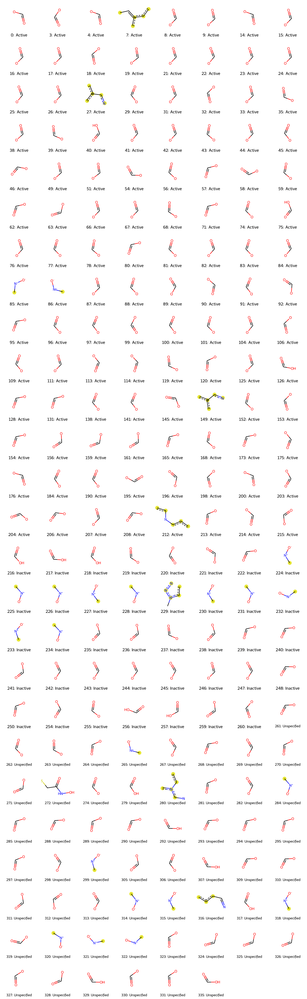

In [ ]:
fragments = []
legends = []
actives_present = 0
actives_not_present = 0
inactives_present = 0
inactives_not_present = 0
for x in range(0, 217):
  if 417 in rdkbi_list[x]:
    actives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 417, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    actives_not_present +=1

for x in range(217, 336):
  if 417 in rdkbi_list[x]:
    inactives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 417, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    inactives_not_present +=1

fbg["417"] = [actives_present, inactives_present]

print("Actives with FP present: " + str(actives_present))
print("Actives with FP not present: " + str(actives_not_present))
print("Inactives with FP present: " + str(inactives_present))
print("Inactives with FP not present: " + str(inactives_not_present))

img = Draw.DrawRDKitBits(fragments, molsPerRow=8, legends=legends)
img

In [ ]:
rdkbi2 = rdkbi_list[0]
samples.append((df2.Structure[0], 417, rdkbi2))
samples_legend.append("417.1")
rdkbi2 = rdkbi_list[226]
samples.append((df2.Structure[226], 417, rdkbi2))
samples_legend.append("417.2")

Actives with FP present: 148
Actives with FP not present: 69
Inactives with FP present: 21
Inactives with FP not present: 98


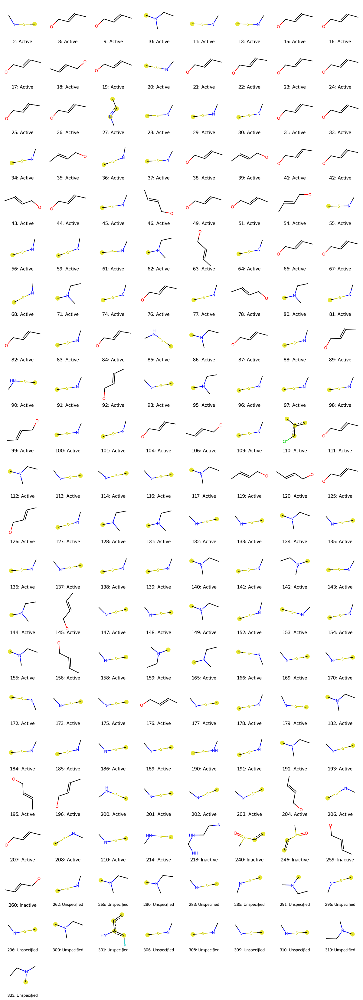

In [ ]:
fragments = []
legends = []
actives_present = 0
actives_not_present = 0
inactives_present = 0
inactives_not_present = 0
for x in range(0, 217):
  if 263 in rdkbi_list[x]:
    actives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 263, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    actives_not_present +=1

for x in range(217, 336):
  if 263 in rdkbi_list[x]:
    inactives_present +=1
    structure = df2.Structure[x]
    rdkbi2 = rdkbi_list[x]
    fragments.append((structure, 263, rdkbi2))
    legends.append(str(x) + ": " + str(df2.Activity[x]))
  else:
    inactives_not_present +=1

fbg["263"] = [actives_present, inactives_present]

print("Actives with FP present: " + str(actives_present))
print("Actives with FP not present: " + str(actives_not_present))
print("Inactives with FP present: " + str(inactives_present))
print("Inactives with FP not present: " + str(inactives_not_present))

img = Draw.DrawRDKitBits(fragments, molsPerRow=8, legends=legends)
img

In [ ]:
rdkbi2 = rdkbi_list[8]
samples.append((df2.Structure[8], 263, rdkbi2))
samples_legend.append("263.1")
rdkbi2 = rdkbi_list[28]
samples.append((df2.Structure[28], 263, rdkbi2))
samples_legend.append("263.2")

Let's now create a bar graph using our dictionary to determine the classification of these fingerprints by graphing the number of actives and inactives containing each fingerprint.

In [ ]:
fbg

{'495': [180, 31],
 '433': [29, 71],
 '382': [193, 51],
 '338': [46, 89],
 '350': [41, 76],
 '193': [144, 17],
 '74': [205, 55],
 '417': [113, 93],
 '263': [148, 21]}

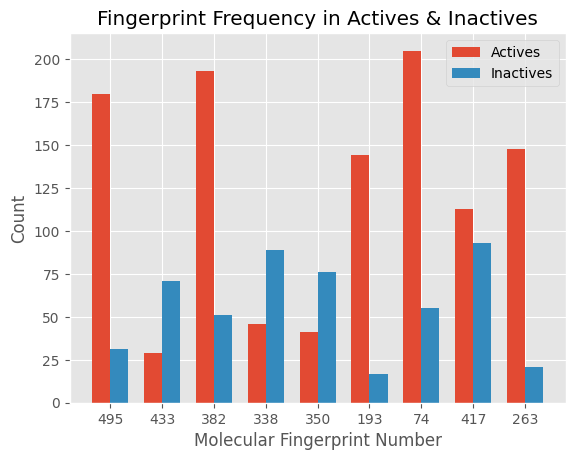

In [ ]:
fingerprints = list(fbg.keys())

actives = [entry[0] for entry in fbg.values()]
inactives = [entry[1] for entry in fbg.values()]

bar_width = 0.35
index = np.arange(len(fingerprints))

plt.bar(index, actives, bar_width, label='Actives')
plt.bar(index + bar_width, inactives, bar_width, label='Inactives')

plt.xlabel('Molecular Fingerprint Number')
plt.ylabel('Count')
plt.title('Fingerprint Frequency in Actives & Inactives')
plt.xticks(index + bar_width / 2, fingerprints)
plt.legend()
plt.show()

It seems that fingerprints 495, 382, 193, 74, and 263 are possible indications of activity while fingerprints 433, 338, and 350 are possible indications of inactivity. Fingerprint 417 is too even to make an educated conclusion.

Below are the substructure predictions for each fingerprint that we chose. For each fingerprint, the first substructure (.1) we chose will most likely be the right prediction but any others may or may not be.

Let's test it out by finding all molecules in our dataset that contain all 5 fingerprints relating to perceived activity and examine which substructures are actually substantial.

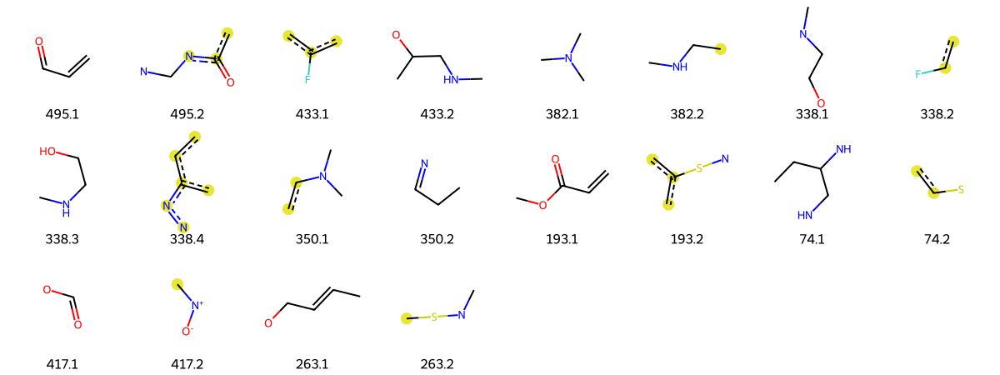

In [ ]:
img2 = Draw.DrawRDKitBits(samples, molsPerRow=8, legends=samples_legend)
img2

Actives (116): [2, 8, 9, 11, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31, 33, 34, 35, 36, 38, 39, 41, 42, 43, 44, 45, 46, 49, 51, 54, 56, 59, 63, 64, 66, 67, 68, 74, 76, 77, 78, 81, 82, 83, 84, 87, 88, 89, 90, 91, 92, 93, 96, 97, 98, 99, 100, 101, 104, 106, 109, 111, 113, 114, 116, 117, 119, 120, 125, 126, 127, 132, 133, 135, 137, 138, 139, 141, 145, 147, 148, 153, 156, 158, 166, 169, 170, 172, 175, 176, 177, 178, 179, 184, 185, 186, 189, 190, 191, 192, 193, 195, 196, 200, 201, 202, 203, 204, 207, 210, 214]
Inactives (6): [259, 260, 262, 283, 296, 306]


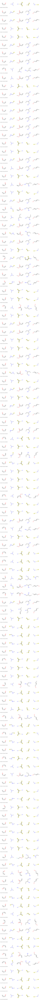

In [ ]:
fragments = []
legends = []
molecules_with_full_actives = []
molecules_with_full_inactives = []
for x in range(0, 217):
  if 495 in rdkbi_list[x] and 382 in rdkbi_list[x] and 193 in rdkbi_list[x] and 74 in rdkbi_list[x] and 263 in rdkbi_list[x]:
    molecules_with_full_actives.append(x)


for m in molecules_with_full_actives:
  structure = df2.Structure[m]
  rdkbi2 = rdkbi_list[m]
  fragments.append((structure, 495, rdkbi2))
  fragments.append((structure, 382, rdkbi2))
  fragments.append((structure, 193, rdkbi2))
  fragments.append((structure, 74, rdkbi2))
  fragments.append((structure, 263, rdkbi2))
  for i in range (0, 5):
    if (i == 0):
      legends.append("Molecule " + str(m) + " (" + str(df2.Activity[m]) + ") " + str(df2.CID[m]))
    else:
      legends.append("")

for x in range(217, 336):
  if 495 in rdkbi_list[x] and 382 in rdkbi_list[x] and 193 in rdkbi_list[x] and 74 in rdkbi_list[x] and 263 in rdkbi_list[x]:
    molecules_with_full_inactives.append(x)

for m in molecules_with_full_inactives:
  structure = df2.Structure[m]
  rdkbi2 = rdkbi_list[m]
  fragments.append((structure, 495, rdkbi2))
  fragments.append((structure, 382, rdkbi2))
  fragments.append((structure, 193, rdkbi2))
  fragments.append((structure, 74, rdkbi2))
  fragments.append((structure, 263, rdkbi2))
  for i in range (0, 5):
    if (i == 0):
      legends.append("Molecule " + str(m) + " (" + str(df2.Activity[m]) + ") " + str(df2.CID[m]))
    else:
      legends.append("")


print("Actives (" + str(len(molecules_with_full_actives)) + "): " + str(molecules_with_full_actives))
print("Inactives (" + str(len(molecules_with_full_inactives)) + "): " + str(molecules_with_full_inactives))
img3 = Draw.DrawRDKitBits(fragments, molsPerRow=5, legends=legends)
img3

Interestingly, the first fingerprint (495) actually has only one important substructure. The other 4 fingerprints have generally 2 substructures and our predictions were  quite accurate for them.

It is important, however, to examine the 6 inactive molecules with our perceived active substructures and determine what exactly prevents its inhibiting classification. We will look at this later when doing some descriptor analysis.

Let's just confirm whether any actives have all 3 perceived inactive fingerprints as well.

In [ ]:
fragments = []
legends = []
molecules_with_full_actives = []
molecules_with_full_inactives = []
for x in range(0, 217):
  if 433 in rdkbi_list[x] and 338 in rdkbi_list[x] and 350 in rdkbi_list[x]:
    molecules_with_full_actives.append(x)

print("Actives (" + str(len(molecules_with_full_actives)) + "): " + str(molecules_with_full_actives))

Actives (0): []


As expected, none have all 3.

4.3: Analyze Descriptors of Highest Importance and the relationships between all features

Let's get the names of the highest importance molecules descriptor features

In [ ]:
important_desc_nums = [df4.columns[x] for x in top_indices_desc]
df_important_desc = df4[important_desc_nums]
df_important_desc["Activity"] = df4["Activity Value"]
df_important_desc

,NumSaturatedHeterocycles,NumSaturatedRings,SMR_VSA6,VSA_EState3,BCUT2D_CHGHI,SlogP_VSA2,BCUT2D_CHGLO,PEOE_VSA12,BCUT2D_MRHI,PEOE_VSA8,Activity
0,1,1,45.16,2.65,2.25,78.84,-2.34,11.81,9.09,26.18,1
1,1,5,38.05,2.80,2.55,65.58,-2.57,17.72,9.09,26.18,1
2,1,1,51.72,3.99,2.31,76.26,-2.34,21.84,7.89,56.73,1
3,1,5,44.66,2.75,2.51,72.37,-2.56,11.81,9.09,31.59,1
4,1,1,45.71,4.23,2.25,79.39,-2.34,11.81,6.27,26.18,1
...,...,...,...,...,...,...,...,...,...,...,...
331,0,0,12.30,15.04,2.27,51.77,-2.14,5.91,7.99,20.27,0
332,0,0,5.32,2.46,2.26,11.69,-1.91,0.00,6.51,0.00,0
333,0,0,9.80,0.00,2.37,23.38,-2.22,0.00,6.52,0.00,0
334,0,0,0.00,9.27,2.00,15.87,-1.95,0.00,6.06,17.96,0


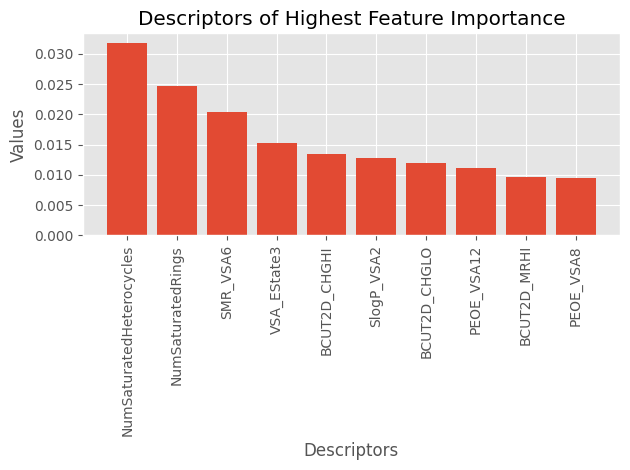

In [ ]:
plt.bar(range(1, 11), feature_importance[top_indices_desc], tick_label=df_important_desc.iloc[:, :-1].columns, align='center')
plt.title('Descriptors of Highest Feature Importance')
plt.ylabel('Values')
plt.xlabel('Descriptors')
plt.xticks(rotation='vertical')
plt.tight_layout()
plt.show()

In [ ]:
correlation_matrix4 = df4.corr()
highly_correlated_pairs4 = (correlation_matrix4.abs() >= 0.57) & (correlation_matrix4.abs() < 1)
highly_correlated_pairs_stack4 = highly_correlated_pairs4.stack()
highly_correlated_pairs_list4 = highly_correlated_pairs_stack4[highly_correlated_pairs_stack4].index.tolist()
fing_desc_ones = df4.columns[np.concatenate([top_indices_fing, top_indices_desc])]
for l in highly_correlated_pairs_list4:
  if (l[0] == 193 or l[1] == 193):
    print(l)

(91, 193)
(173, 193)
(193, 91)
(193, 173)
(193, 263)
(193, 272)
(193, 'MinEStateIndex')
(193, 'BCUT2D_CHGHI')
(193, 'fr_sulfonamd')
(263, 193)
(272, 193)
('MinEStateIndex', 193)
('BCUT2D_CHGHI', 193)
('fr_sulfonamd', 193)


We can generate a correlation matrix for the descriptors, identifying which pairs are correlated with each other. This can help us find how combinations of features that affect activity.

[('NumSaturatedHeterocycles', 'NumSaturatedRings'), ('NumSaturatedRings', 'NumSaturatedHeterocycles'), ('NumSaturatedRings', 'BCUT2D_CHGHI'), ('NumSaturatedRings', 'SlogP_VSA2'), ('NumSaturatedRings', 'BCUT2D_CHGLO'), ('SMR_VSA6', 'BCUT2D_CHGLO'), ('BCUT2D_CHGHI', 'NumSaturatedRings'), ('SlogP_VSA2', 'NumSaturatedRings'), ('SlogP_VSA2', 'PEOE_VSA12'), ('BCUT2D_CHGLO', 'NumSaturatedRings'), ('BCUT2D_CHGLO', 'SMR_VSA6'), ('PEOE_VSA12', 'SlogP_VSA2')]


<Axes: >

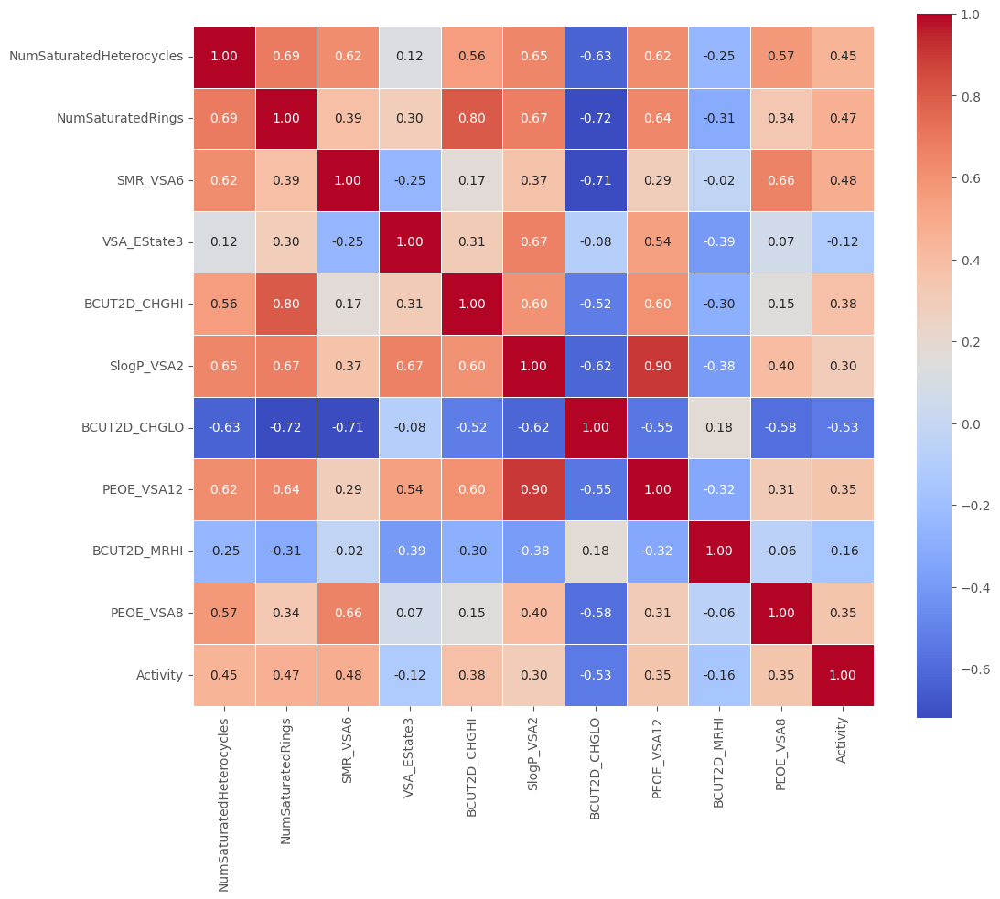

In [ ]:
correlation_matrix = df_important_desc.corr()
highly_correlated_pairs = (correlation_matrix.abs() >= 0.67) & (correlation_matrix.abs() < 1)
highly_correlated_pairs_stack = highly_correlated_pairs.stack()
highly_correlated_pairs_list = highly_correlated_pairs_stack[highly_correlated_pairs_stack].index.tolist()
print(highly_correlated_pairs_list)
plt.figure(figsize=(12, 10))
sn.heatmap(correlation_matrix, annot=True, cmap="coolwarm", linewidths=.5, fmt=".2f", square=True)

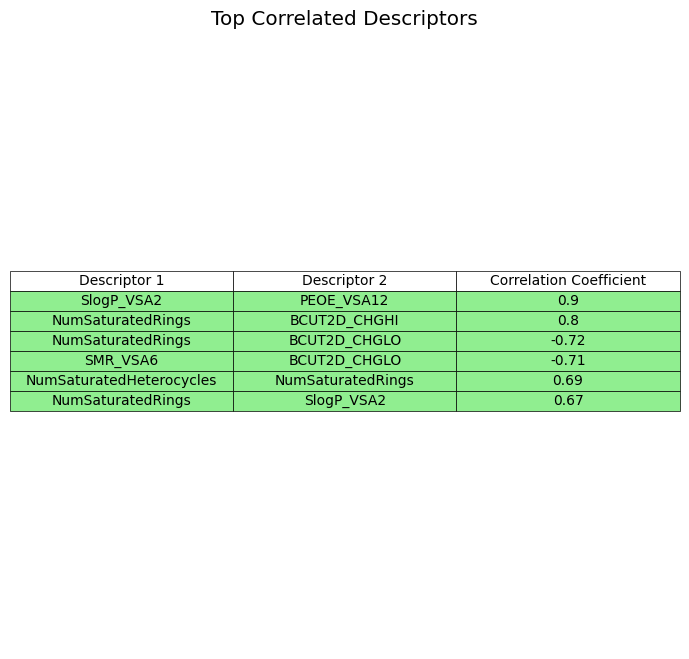

In [ ]:
top_correlation_df = pd.DataFrame(columns=['Descriptor 1', 'Descriptor 2', 'Correlation Coefficient'])

for pair in highly_correlated_pairs_list:
    desc1, desc2 = pair
    correlation_coefficient = correlation_matrix.loc[desc1, desc2]
    top_correlation_df = top_correlation_df.append({'Descriptor 1': desc1, 'Descriptor 2': desc2, 'Correlation Coefficient': correlation_coefficient}, ignore_index=True)

top_correlation_df = top_correlation_df.reindex(top_correlation_df['Correlation Coefficient'].abs().sort_values(ascending=False).index)
top_correlation_df = top_correlation_df.iloc[[0, 2, 4, 6, 8, 10]]
fig, ax = plt.subplots(figsize=(8, 8))

table_data = top_correlation_df.round(2)
table = ax.table(cellText=table_data.values,
                 rowLabels=None,
                 colLabels=table_data.columns,
                 loc='center',
                 cellLoc='center',
                 colWidths=[0.3]*len(table_data.columns),
                 cellColours=[['lightgreen']*3]*6)

table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1.2, 1.2)

ax.axis('off')

plt.title('Top Correlated Descriptors')
plt.show()

We can also do get correlations between certain fingerprints with each other and also between fingerprints and descriptors. The latter would be quite useful because certain substructures are highly responsible for properties.

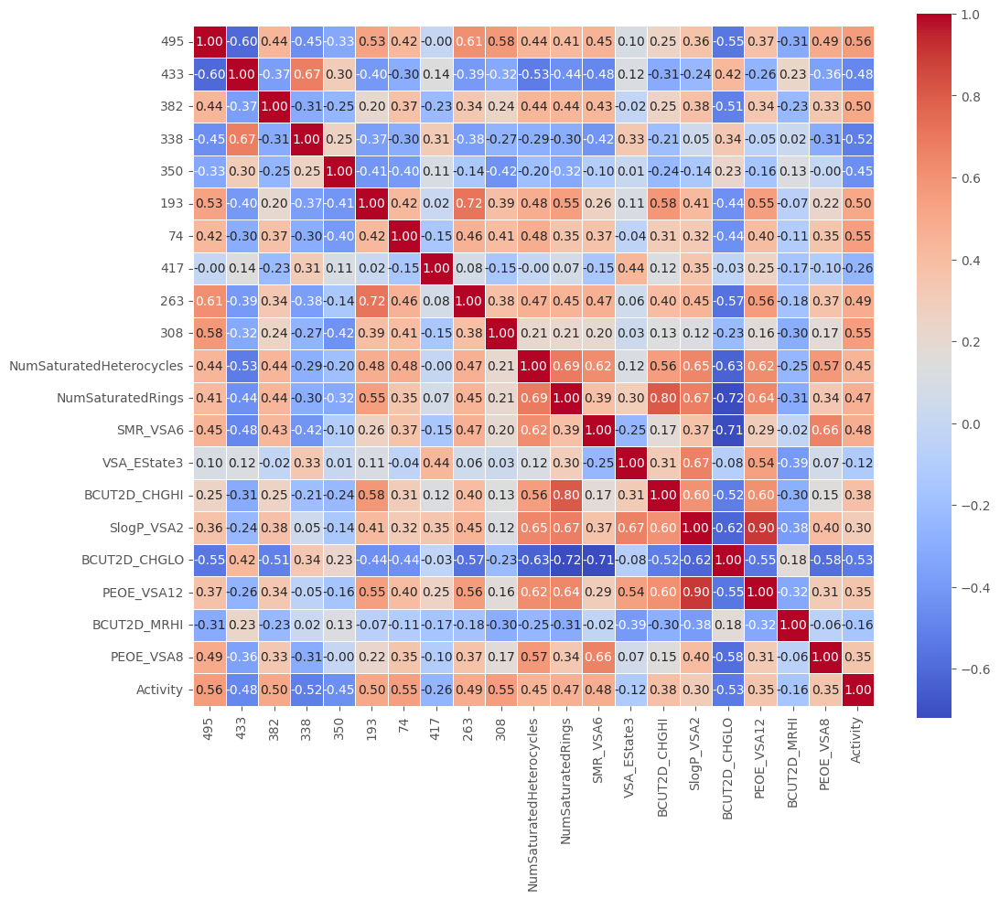

In [ ]:
descs_and_fings_for_cor = df4.columns[np.concatenate([top_indices_fing, top_indices_desc])]
df_descs_fings = df4[descs_and_fings_for_cor]
df_descs_fings["Activity"] = df4["Activity Value"]

correlation_matrix2 = df_descs_fings.corr()

plt.figure(figsize=(12, 10))
sn.heatmap(correlation_matrix2, annot=True, cmap="coolwarm", linewidths=.5, fmt=".2f", square=True)
plt.show()

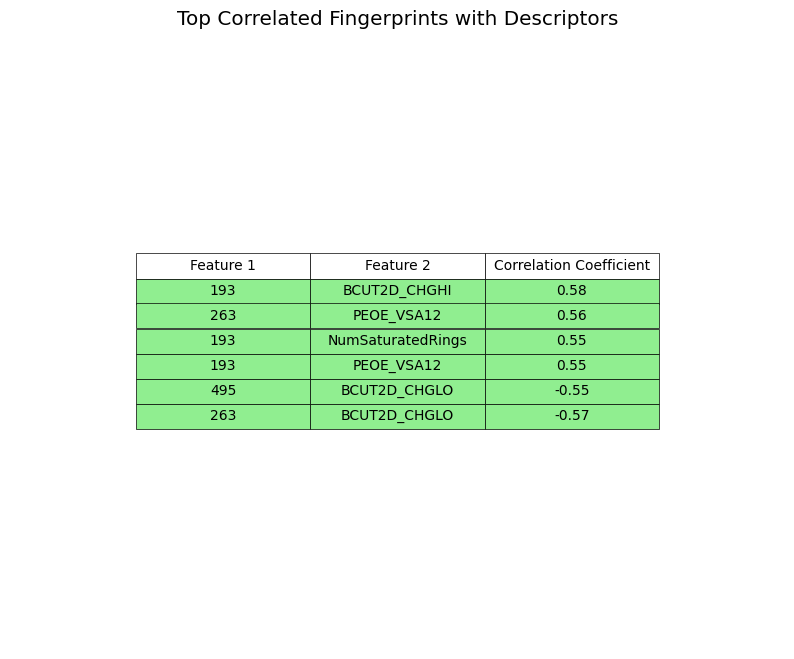

In [ ]:
highly_correlated_pairs2 = (correlation_matrix2.abs() >= 0.53) & (correlation_matrix2.abs() < 1)
highly_correlated_pairs_stack2 = highly_correlated_pairs2.stack()
highly_correlated_pairs_list2 = highly_correlated_pairs_stack2[highly_correlated_pairs_stack2].index.tolist()

highly_correlated_pairs_list2 = [pair for pair in highly_correlated_pairs_list2 if isinstance(pair[0], int) or isinstance(pair[1], int)]
highly_correlated_pairs_list2 = [pair for pair in highly_correlated_pairs_list2 if not isinstance(pair[1], int)]
highly_correlated_pairs_list2 = [pair for pair in highly_correlated_pairs_list2 if not pair[0] == "Activity" and  not pair[1] == "Activity"]


correlation_df2 = pd.DataFrame(columns=['Feature 1', 'Feature 2', 'Correlation Coefficient'])

for pair in highly_correlated_pairs_list2:
    feature1, feature2 = pair
    correlation_coefficient = correlation_matrix2.loc[feature1, feature2]
    correlation_df2 = correlation_df2.append({'Feature 1': feature1, 'Feature 2': feature2, 'Correlation Coefficient': correlation_coefficient}, ignore_index=True)

correlation_df2 = correlation_df2.sort_values(by='Correlation Coefficient', ascending=False)

fig, ax = plt.subplots(figsize=(10, 8))

table_data2 = correlation_df2.round(2)
table2 = ax.table(cellText=table_data2.values,
                  rowLabels=None,
                  colLabels=table_data2.columns,
                  loc='center',
                  cellLoc='center',
                  colWidths=[0.15]*len(table_data2.columns),
                  cellColours=[['lightgreen']*3]*6)


table2.auto_set_font_size(False)
table2.set_fontsize(10)
table2.scale(1.5, 1.5)

ax.axis('off')

plt.title('Top Correlated Fingerprints with Descriptors')
plt.show()

Let's first create a pairplot for a visual of all correlations between the features. This is simply for reference and may be useful later on in our analysis.

In [ ]:
# sn.pairplot(df_descs_fings, hue='Activity', palette={0: 'red', 1: 'blue'}, markers=['o', 's'])
# plt.suptitle('Pairplot of Variables by Bioactivity Class', y=1.02)
# plt.show()

Using the correlation matrix we generated, we can plot each pair's correlation and their effect on bioactivity. Make sure that you are not repeating the same combinations. We can also individually plot the inactives with active fingerprints in green.

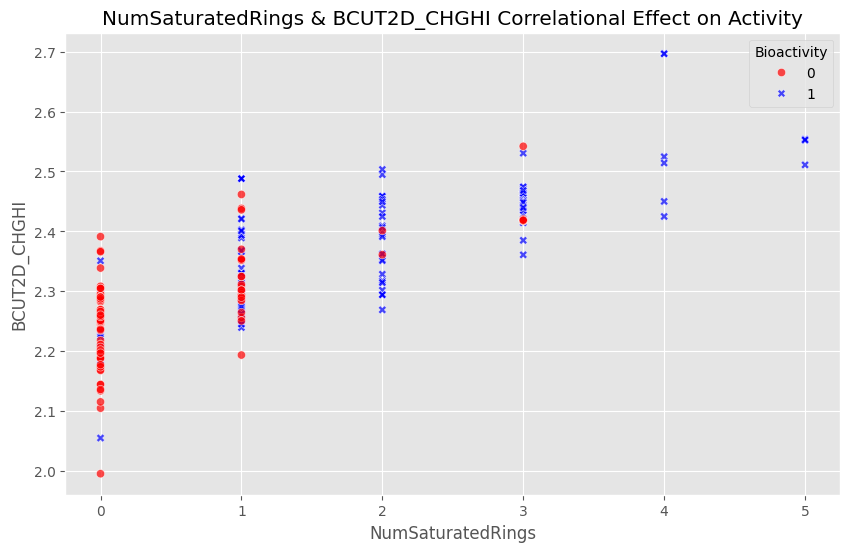

In [ ]:
df_desc_1 = df_important_desc[['NumSaturatedRings', 'BCUT2D_CHGHI', 'Activity']]

plt.figure(figsize=(10, 6))
sn.scatterplot(x='NumSaturatedRings', y='BCUT2D_CHGHI', hue='Activity',style='Activity', data=df_desc_1, palette={0: 'red', 1: 'blue'}, alpha=0.7)
# plt.scatter(x=highlighted_points['NumSaturatedRings'], y=highlighted_points['BCUT2D_CHGHI'], color='green', s=50, marker='^', label='Inactives with Active Fingerprints')
plt.title('NumSaturatedRings & BCUT2D_CHGHI Correlational Effect on Activity')
plt.xlabel('NumSaturatedRings')
plt.ylabel('BCUT2D_CHGHI')
plt.legend(title='Bioactivity')
plt.show()

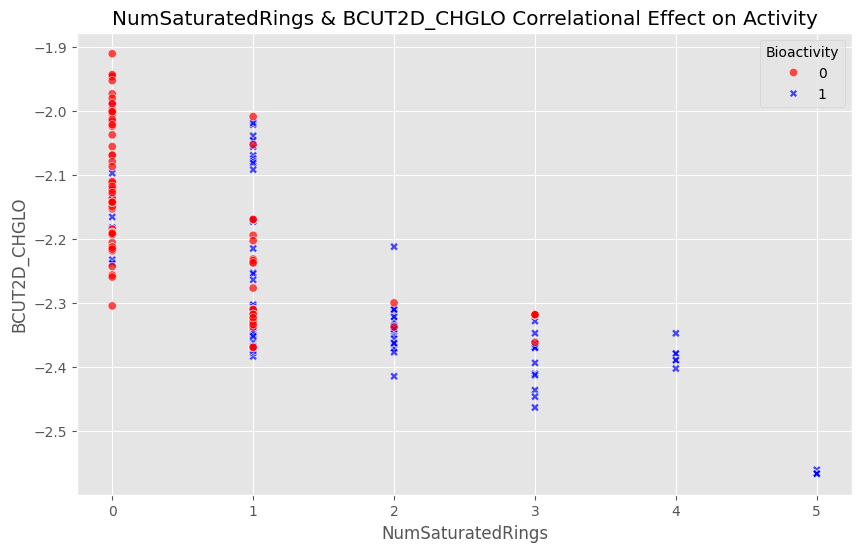

In [ ]:
df_desc_2 = df_important_desc[['NumSaturatedRings', 'BCUT2D_CHGLO', 'Activity']]

plt.figure(figsize=(10, 6))
sn.scatterplot(x='NumSaturatedRings', y='BCUT2D_CHGLO', hue='Activity',style='Activity', data=df_desc_2, palette={0: 'red', 1: 'blue'}, alpha=0.7)
# plt.scatter(x=highlighted_points['NumSaturatedRings'], y=highlighted_points['BCUT2D_CHGLO'], color='green', s=50, marker='^', label='Inactives with Active Fingerprints')
plt.title('NumSaturatedRings & BCUT2D_CHGLO Correlational Effect on Activity')
plt.xlabel('NumSaturatedRings')
plt.ylabel('BCUT2D_CHGLO')
plt.legend(title='Bioactivity')
plt.show()

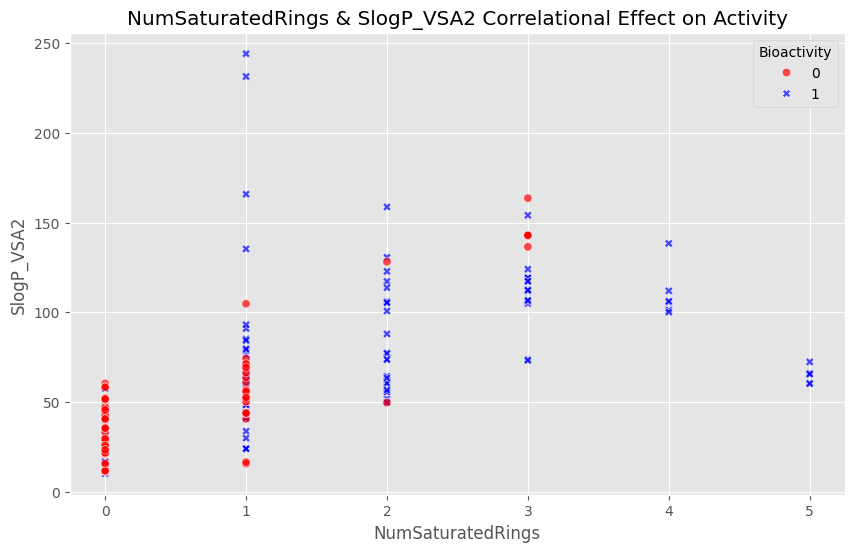

In [ ]:
df_desc_3 = df_important_desc[['NumSaturatedRings', 'SlogP_VSA2', 'Activity']]

plt.figure(figsize=(10, 6))
sn.scatterplot(x='NumSaturatedRings', y='SlogP_VSA2', hue='Activity',style='Activity', data=df_desc_3, palette={0: 'red', 1: 'blue'}, alpha=0.7)
# plt.scatter(x=highlighted_points['NumSaturatedRings'], y=highlighted_points['BCUT2D_CHGHI'], color='green', s=50, marker='^', label='Inactives with Active Fingerprints')
plt.title('NumSaturatedRings & SlogP_VSA2 Correlational Effect on Activity')
plt.xlabel('NumSaturatedRings')
plt.ylabel('SlogP_VSA2')
plt.legend(title='Bioactivity')
plt.show()

It would also be good to observe the correlation between the first two features. They are whole number features so making a scatterplot would not be useful. Let's generate a double histogram for all the combinations.

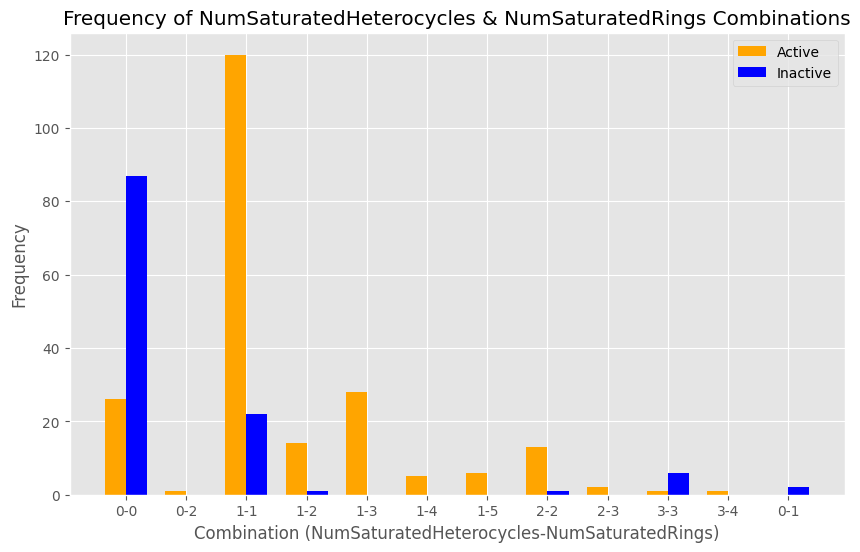

In [ ]:
active_desc = df_important_desc.iloc[:217]
inactive_desc = df_important_desc.iloc[217:336]

active_counts = active_desc.groupby(['NumSaturatedHeterocycles', 'NumSaturatedRings']).size().reset_index(name='Active_Count')

inactive_counts = inactive_desc.groupby(['NumSaturatedHeterocycles', 'NumSaturatedRings']).size().reset_index(name='Inactive_Count')

merged_counts = pd.merge(active_counts, inactive_counts, on=['NumSaturatedHeterocycles', 'NumSaturatedRings'], how='outer').fillna(0)

fig, ax = plt.subplots(figsize=(10, 6))
bar_width = 0.35
index = range(len(merged_counts))


plt.bar(index, merged_counts['Active_Count'], bar_width, label='Active', color='orange')

plt.bar([i + bar_width for i in index], merged_counts['Inactive_Count'], bar_width, label='Inactive', color='blue')

plt.xlabel('Combination (NumSaturatedHeterocycles-NumSaturatedRings)')
plt.xticks([i + bar_width / 2 for i in index], merged_counts[['NumSaturatedHeterocycles', 'NumSaturatedRings']].astype(str).agg('-'.join, axis=1))

plt.ylabel('Frequency')

plt.legend()

plt.title('Frequency of NumSaturatedHeterocycles & NumSaturatedRings Combinations')
plt.show()

In [ ]:
d13 = pd.DataFrame()
df13 = df4.iloc[molecules_with_full_actives, :]
df13[[193, 'BCUT2D_CHGHI', 'NumSaturatedRings', 'NumSaturatedHeterocycles']]

,193,BCUT2D_CHGHI,NumSaturatedRings,NumSaturatedHeterocycles
2,1,2.31,1,1
8,1,2.46,3,1
9,1,2.46,3,1
11,1,2.55,5,1
13,1,2.55,5,1
...,...,...,...,...
203,1,2.28,1,1
204,1,2.40,1,1
207,1,2.70,4,1
210,1,2.30,1,1


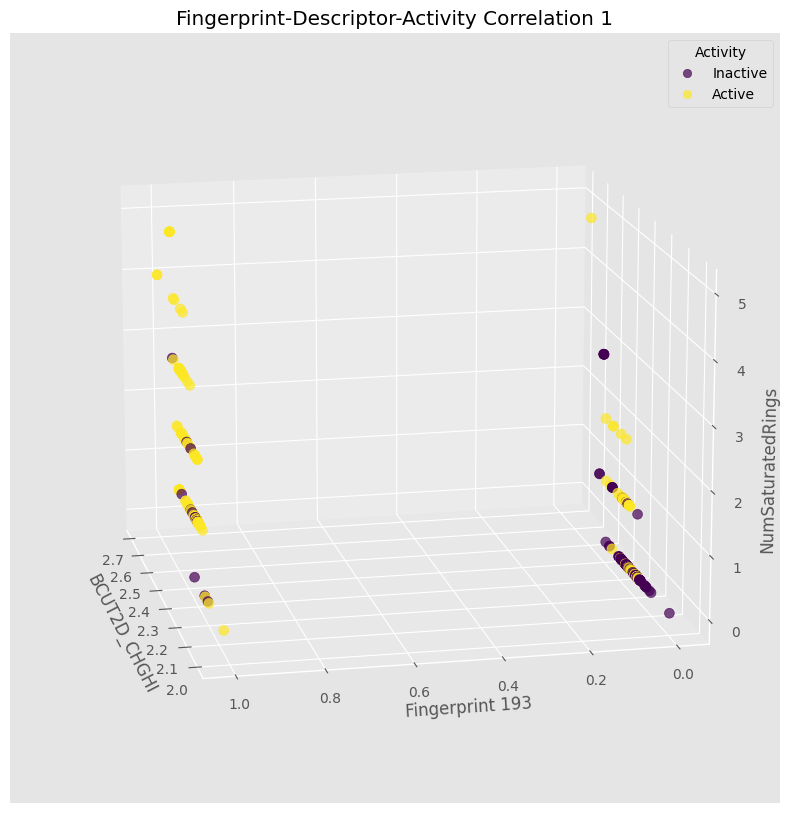

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(df4['BCUT2D_CHGHI'], df4[193], df4['NumSaturatedRings'], c=df4['Activity Value'], marker='o' , cmap='viridis', s=50, alpha=0.7)
ax.set_xlabel('BCUT2D_CHGHI')
ax.set_ylabel('Fingerprint 193')
ax.set_zlabel('NumSaturatedRings')
ax.set_title('Fingerprint-Descriptor-Activity Correlation 1')

legend_labels = ['Inactive', 'Active']
ax.legend(handles=scatter.legend_elements()[0], labels=legend_labels, title='Activity')

ax.view_init(elev=15, azim=168)

plt.show()

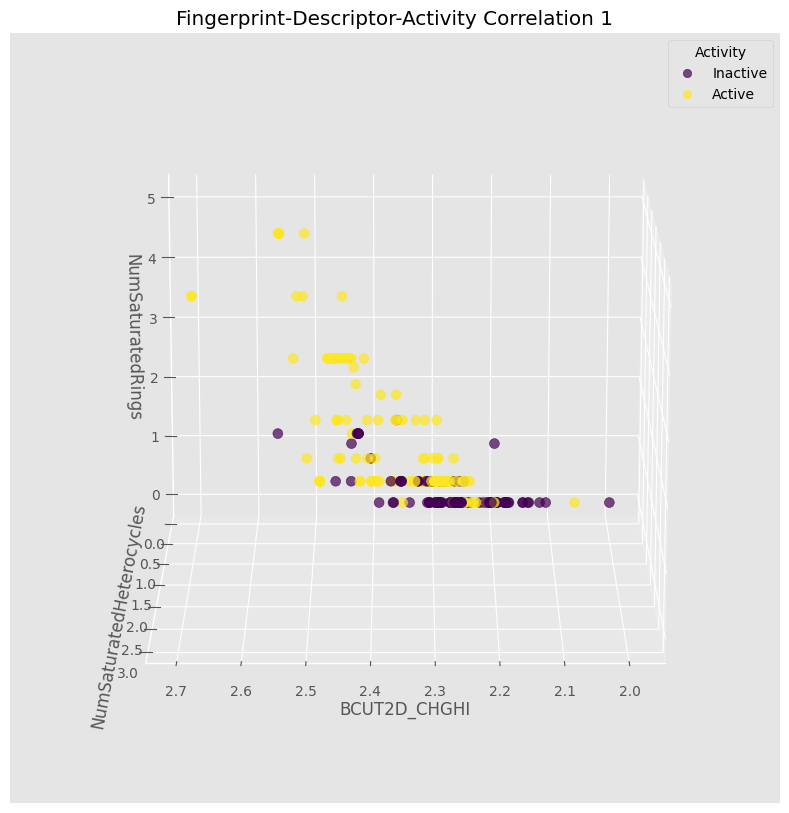

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(df4['BCUT2D_CHGHI'], df4['NumSaturatedHeterocycles'], df4['NumSaturatedRings'], c=df4['Activity Value'], marker='o' , cmap='viridis', s=50, alpha=0.7)
ax.set_xlabel('BCUT2D_CHGHI')
ax.set_ylabel('NumSaturatedHeterocycles')
ax.set_zlabel('NumSaturatedRings')
ax.set_title('Fingerprint-Descriptor-Activity Correlation 1')

legend_labels = ['Inactive', 'Active']
ax.legend(handles=scatter.legend_elements()[0], labels=legend_labels, title='Activity')

ax.view_init(elev=15, azim=156)

plt.show()

In [ ]:
df14 = pd.DataFrame()
df14 = df4.iloc[molecules_with_full_actives, :]
df14[[263,'BCUT2D_CHGLO', 'NumSaturatedRings', 'NumSaturatedHeterocycles']]

,263,BCUT2D_CHGLO,NumSaturatedRings,NumSaturatedHeterocycles
2,1,-2.34,1,1
8,1,-2.37,3,1
9,1,-2.37,3,1
11,1,-2.57,5,1
13,1,-2.57,5,1
...,...,...,...,...
203,1,-2.21,1,1
204,1,-2.31,1,1
207,1,-2.39,4,1
210,1,-2.31,1,1


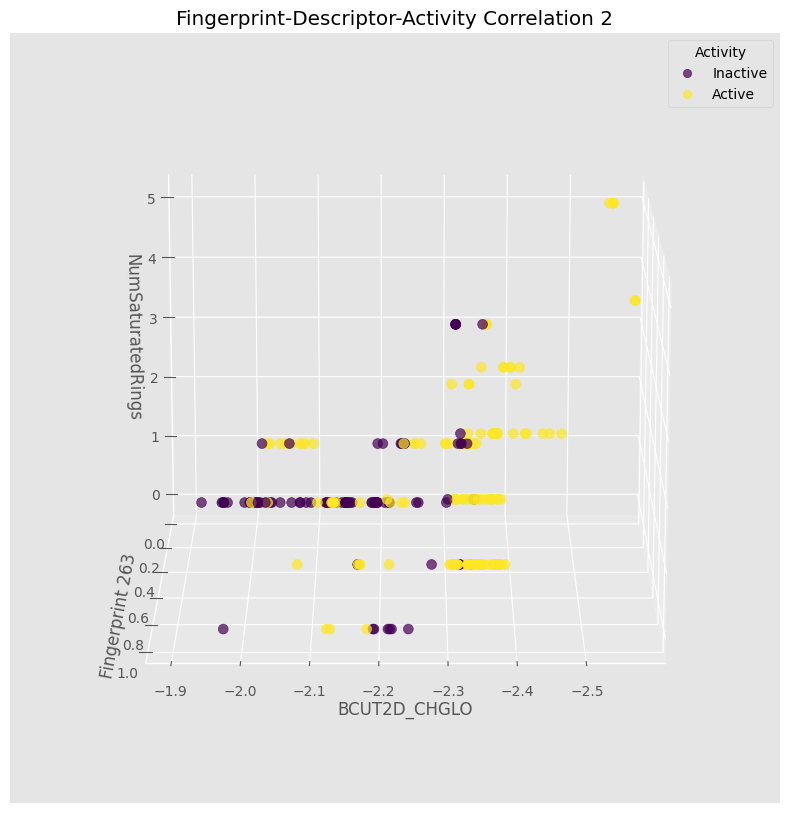

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(df4['BCUT2D_CHGLO'], df4[263], df4['NumSaturatedRings'], c=df4['Activity Value'], marker='o' , cmap='viridis', s=50, alpha=0.7)
ax.set_xlabel('BCUT2D_CHGLO')
ax.set_ylabel('Fingerprint 263')
ax.set_zlabel('NumSaturatedRings')
ax.set_title('Fingerprint-Descriptor-Activity Correlation 2')

legend_labels = ['Inactive', 'Active']
ax.legend(handles=scatter.legend_elements()[0], labels=legend_labels, title='Activity')

ax.view_init(elev=15, azim=168)

plt.show()

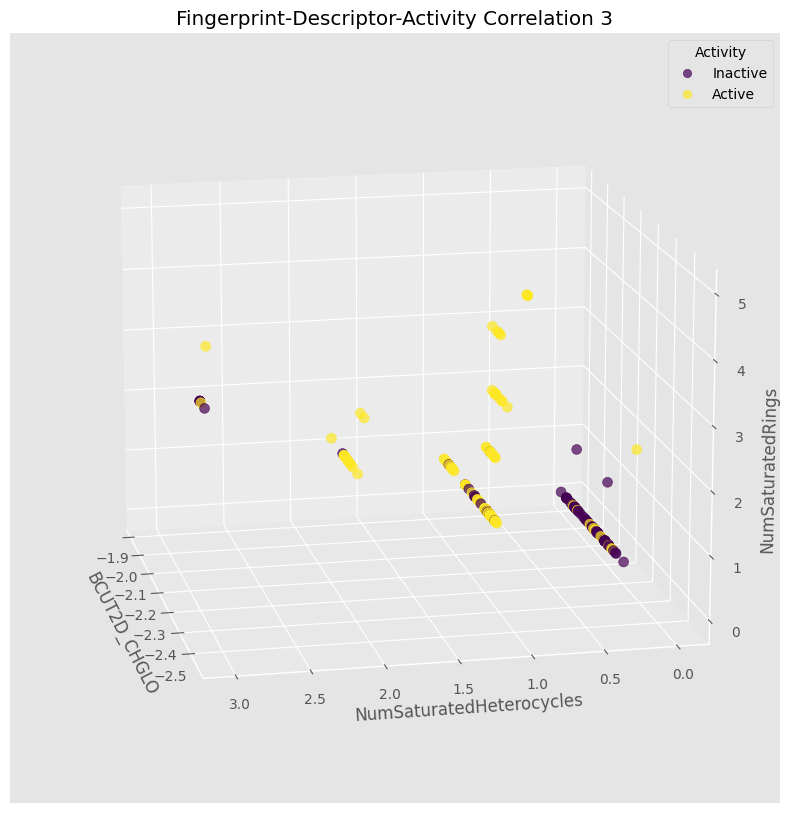

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(df4['BCUT2D_CHGLO'], df4['NumSaturatedHeterocycles'], df4['NumSaturatedRings'], c=df4['Activity Value'], marker='o' , cmap='viridis', s=50, alpha=0.7)
ax.set_xlabel('BCUT2D_CHGLO')
ax.set_ylabel('NumSaturatedHeterocycles')
ax.set_zlabel('NumSaturatedRings')
ax.set_title('Fingerprint-Descriptor-Activity Correlation 3')

legend_labels = ['Inactive', 'Active']
ax.legend(handles=scatter.legend_elements()[0], labels=legend_labels, title='Activity')

ax.view_init(elev=15, azim=168)

plt.show()

In [ ]:
d15 = pd.DataFrame()
df15 = df4.iloc[molecules_with_full_actives, :]
df15[[193, 263, 'PEOE_VSA12', 'SlogP_VSA2', 'NumSaturatedRings', 'NumSaturatedHeterocycles']]

,193,263,PEOE_VSA12,SlogP_VSA2,NumSaturatedRings,NumSaturatedHeterocycles
2,1,1,21.84,76.26,1,1
8,1,1,29.54,111.96,3,1
9,1,1,29.54,111.96,3,1
11,1,1,27.79,65.58,5,1
13,1,1,21.84,60.60,5,1
...,...,...,...,...,...,...
203,1,1,15.93,55.80,1,1
204,1,1,41.35,135.30,1,1
207,1,1,29.54,106.18,4,1
210,1,1,15.93,50.21,1,1


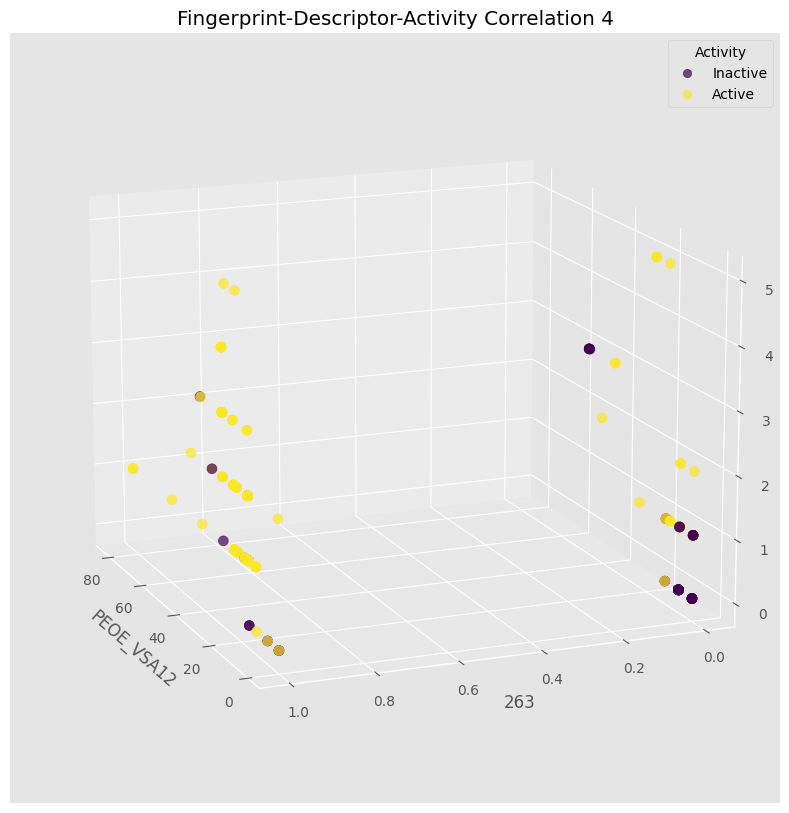

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(df4['PEOE_VSA12'], df4[263], df4['NumSaturatedRings'], c=df4['Activity Value'], marker='o' , cmap='viridis', s=50, alpha=0.7)
ax.set_xlabel('PEOE_VSA12')
ax.set_ylabel('263')
ax.set_zlabel('NumSaturatedRings')
ax.set_title('Fingerprint-Descriptor-Activity Correlation 4')

legend_labels = ['Inactive', 'Active']
ax.legend(handles=scatter.legend_elements()[0], labels=legend_labels, title='Activity')

ax.view_init(elev=15, azim=158)

plt.show()

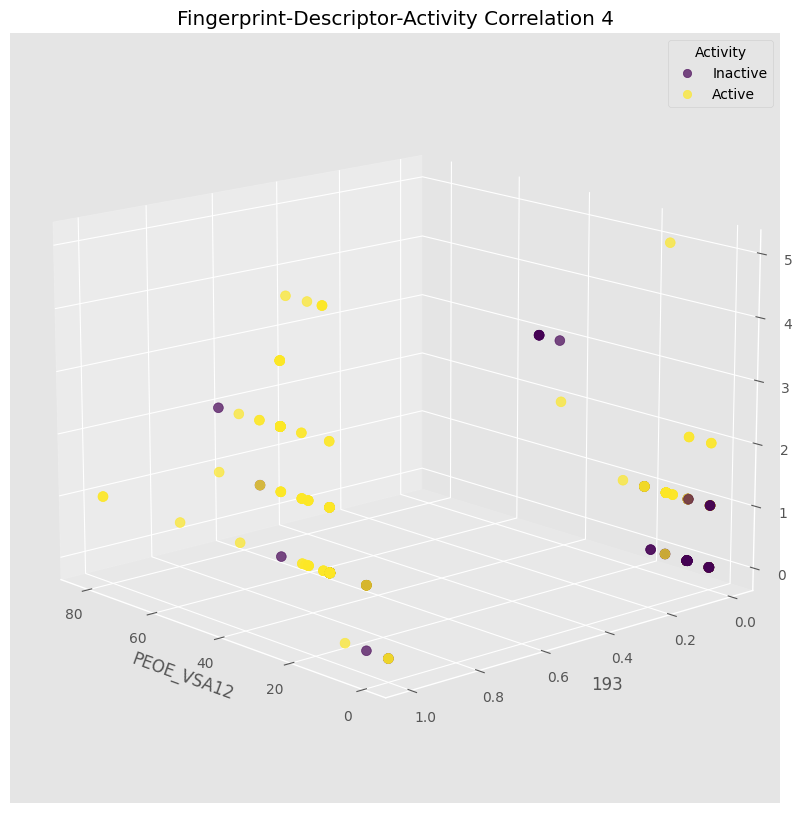

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(df4['PEOE_VSA12'], df4[193], df4['NumSaturatedRings'], c=df4['Activity Value'], marker='o' , cmap='viridis', s=50, alpha=0.7)
ax.set_xlabel('PEOE_VSA12')
ax.set_ylabel('193')
ax.set_zlabel('NumSaturatedRings')
ax.set_title('Fingerprint-Descriptor-Activity Correlation 4')

legend_labels = ['Inactive', 'Active']
ax.legend(handles=scatter.legend_elements()[0], labels=legend_labels, title='Activity')

ax.view_init(elev=15, azim=138)

plt.show()

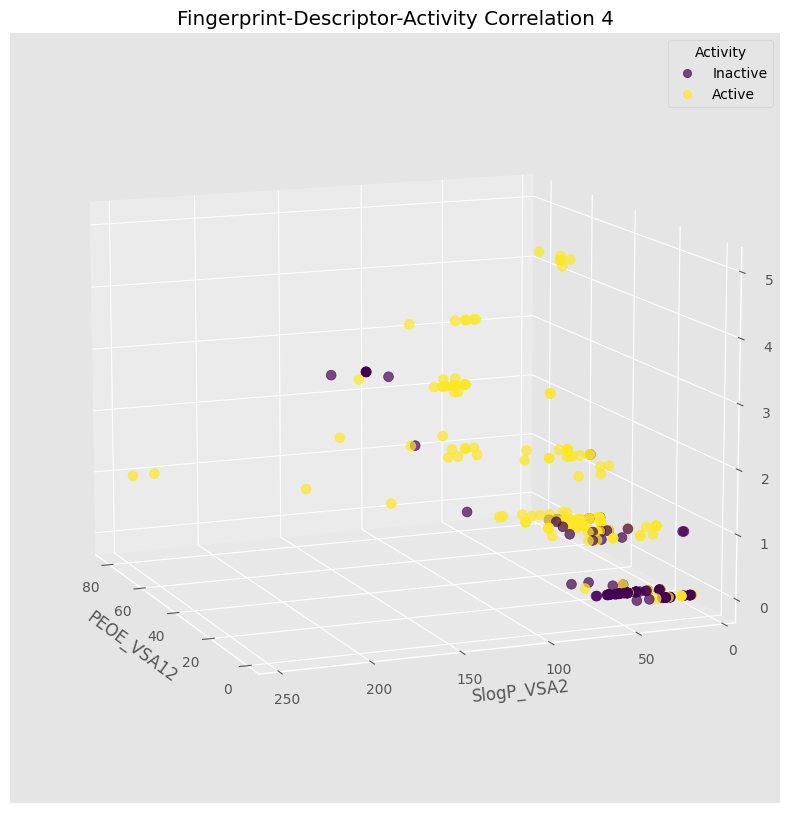

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(df4['PEOE_VSA12'], df4['SlogP_VSA2'], df4['NumSaturatedRings'], c=df4['Activity Value'], marker='o' , cmap='viridis', s=50, alpha=0.7)
ax.set_xlabel('PEOE_VSA12')
ax.set_ylabel('SlogP_VSA2')
ax.set_zlabel('NumSaturatedRings')
ax.set_title('Fingerprint-Descriptor-Activity Correlation 4')

legend_labels = ['Inactive', 'Active']
ax.legend(handles=scatter.legend_elements()[0], labels=legend_labels, title='Activity')

ax.view_init(elev=12, azim=158)

plt.show()

In [188]:
d16 = pd.DataFrame()
df16 = df4.iloc[molecules_with_full_actives, :]
df16 = df16[[193, 263, 'BCUT2D_CHGHI','BCUT2D_CHGLO','PEOE_VSA12', 'SlogP_VSA2', 'NumSaturatedRings', 'NumSaturatedHeterocycles']]
df16 = df16[df16['NumSaturatedHeterocycles'] == 1]
df16 = df16[df16['NumSaturatedRings'] >= 1]
df16 = df16[df16['BCUT2D_CHGLO'] <= -2.32]
df16 = df16[df16['BCUT2D_CHGHI'] >= 2.4]

print(len(df16))
df16

40


,193,263,BCUT2D_CHGHI,BCUT2D_CHGLO,PEOE_VSA12,SlogP_VSA2,NumSaturatedRings,NumSaturatedHeterocycles
8,1,1,2.46,-2.37,29.54,111.96,3,1
9,1,1,2.46,-2.37,29.54,111.96,3,1
11,1,1,2.55,-2.57,27.79,65.58,5,1
13,1,1,2.55,-2.57,21.84,60.60,5,1
15,1,1,2.45,-2.36,29.54,112.97,3,1
16,1,1,2.45,-2.35,29.54,111.96,4,1
17,1,1,2.46,-2.37,29.54,105.87,3,1
18,1,1,2.45,-2.37,29.54,106.18,3,1
21,1,1,2.44,-2.41,29.54,119.39,3,1
22,1,1,2.46,-2.37,29.54,117.00,3,1


Finally, let's generate decision trees for the Random Forest. This is an excellent depiction of how the classifier decides to categorize molecules. Take a look at what feature values influence activity or inactivity. Since we used the default AdaBoost, there will be 10 estimator we can make decision trees for.

In [ ]:
from sklearn.tree import export_graphviz
#
export_graphviz(clf.estimators_[0], out_file='tree.dot',
                feature_names = df4.columns[:-1],
                class_names = ["Inactive", "Active"],
                rounded = True, proportion = False,
                precision = 2, filled = True)

from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

from IPython.display import Image
Image(filename = 'tree.png')

## Step 5: Tanimoto Similarity Analysis
Credit: https://github.com/gashawmg/Molecular-fingerprints/blob/main/Calculating%20molecular%20fingerprints%20available%20in%20RDkit%20.ipynb

5.1: Evaluate the reliability of your dataset by performing similarity analysis

Since most of the datasets you will obtain will be from biological assays of a specific protein, similarity analysis must be done to ensure that the dataset is not "too easy" to learn off of. If the molecules in the dataset are too similar, your model will indeed seem to have great accuracy but once it is introduced to molecules it is not familiar with, let's just say - it won't do very well.

Sometimes drug designing biologists constantly test variations of the same molecule over and over again and create datasets out of these trials. In the first place, we need to be careful about not picking a dataset like from these (thankfully we didn't).

However occasionally, although molecules in a dataset may not seem visually similar, they prove to be when analyzed more closely.

In essence, we want a numerical value when evaluating similarity between two molecules. (e.g. Molecule 1 is 25% similar to Molecule 2)

rdkit has a tool that is excellent for calculating similarity coefficients called tanimoto data structures

Let's start off with calculating the percent similarity of all the molecules in the dataset with the very first molecule.

We call the molecule we are estalishing a comparision off of the query.

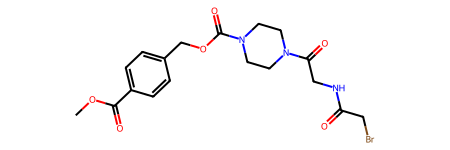

In [ ]:
query = df2.Structure[0]
query_fps = AllChem.RDKFingerprint(query, maxPath=5, fpSize=512)
query

Tanimoto similarity uses fingerprints. It would be best to use the same fingerprints that we trained the model with.

In [ ]:
all_Mfpts = [AllChem.RDKFingerprint(mol, maxPath=5, fpSize=512) for mol in df2.Structure]

The following yields an array of values with tanimoto similarity

In [ ]:
from rdkit import DataStructs
Tanimoto_similarity = [DataStructs.FingerprintSimilarity(query_fps, x, metric=DataStructs.TanimotoSimilarity) for x in all_Mfpts]

We can store this in a dataframe.

,CID,Compound_Name,Smiles,Activity,Activity Value,Structure,tanimoto_values
0,73504704,(4-Methoxycarbonylphenyl)methyl 4-[2-[(2-bromo...,COC(=O)c1ccc(COC(=O)N2CCN(C(=O)CNC(=O)CBr)CC2)cc1,Active,1,,1.00
1,73775396,N-[2-[4-(adamantane-1-carbonyl)piperazin-1-yl]...,O=C(CBr)NCC(=O)N1CCN(C(=O)C23CC4CC(CC(C4)C2)C3...,Active,1,,0.40
2,73775533,N-[2-[4-[[5-(dimethylamino)-1-naphthyl]sulfony...,C=CC(=O)NCC(=O)N1CCN(S(=O)(=O)c2cccc3c(N(C)C)c...,Active,1,,0.36
3,73775247,1-Adamantylmethyl 4-[2-[(2-bromoacetyl)amino]a...,O=C(CBr)NCC(=O)N1CCN(C(=O)OCC23CC4CC(CC(C4)C2)...,Active,1,,0.56
4,73775246,(6-Methoxycarbonyl-2-naphthyl)methyl 4-[2-[(2-...,COC(=O)c1ccc2cc(COC(=O)N3CCN(C(=O)CNC(=O)CCl)C...,Active,1,,0.84
...,...,...,...,...,...,...,...
331,72205083,(2S)-5-oxo-2-[[2-(phenylmethoxycarbonylamino)a...,Cc1c(C)[n+](C)c(SCC(=O)CCC(NC(=O)CNC(=O)OCc2cc...,Unspecified,0,,0.41
332,7054,Isatin,O=C1Nc2ccccc2C1=O,Unspecified,0,,0.35
333,3798517,"1-{4-[(2,3-Dioxo-2,3-dihydro-1H-indol-1-YL)met...",Cc1cc(CN2C(=O)C(=O)c3ccccc32)c(C)cc1CN1C(=O)C(...,Unspecified,0,,0.35
334,6020915,(E)-3-(3-hydroxyphenyl)-1-pyridin-3-ylprop-2-e...,O=C(C=Cc1cccc(O)c1)c1cccnc1,Unspecified,0,,0.30

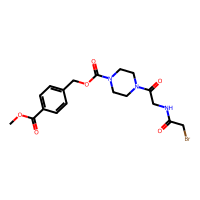
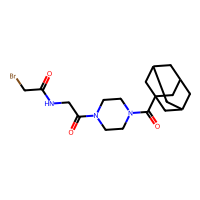
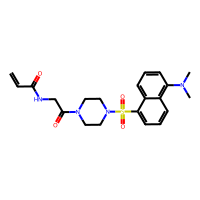
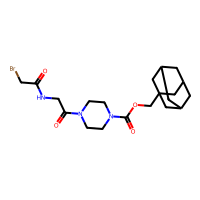
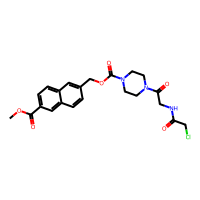
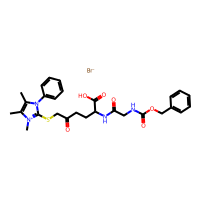
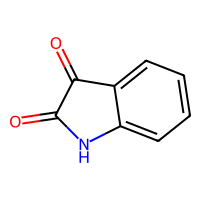
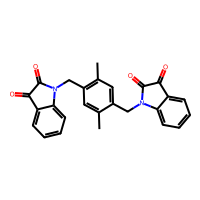
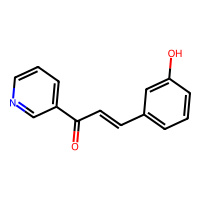
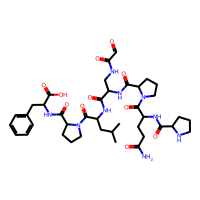

In [ ]:
df2["tanimoto_values"] = Tanimoto_similarity
df2_sorted = df2.sort_values(['tanimoto_values'],ascending=False)
df2

To visualize more clearly, create a grid of the tanimoto values.

Notice that the first molecule has a similarity coefficient of 1.0; Well that is becausing a molecule 1 is obviously 100% similar to itself.

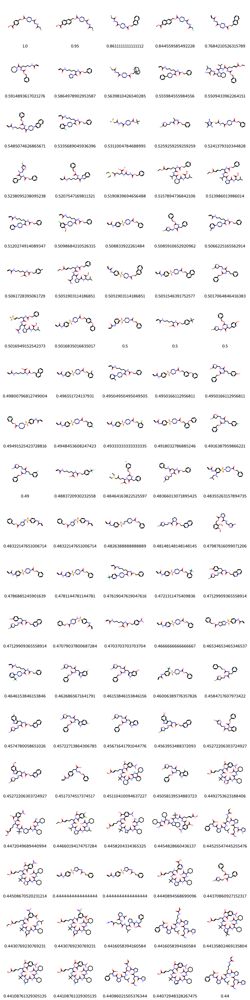

In [ ]:
structures_to_draw = []
legends = []

for x in df2_sorted["Structure"]:
    structures_to_draw.append(x)

legends = [str(x) for x in df2_sorted.tanimoto_values]

Draw.MolsToGridImage(structures_to_draw, maxMols=100, legends=legends, subImgSize=(200, 200), molsPerRow=5)

Overall, from these values which average in around the 0.40-0.50 range show us that most molecules are not insanely similarly to molecule 1.

If you think about, calculating similarity to the first molecule is just the small picture. We want to be able to compare every single molecule to each other. Let's do that now!

In [ ]:
dataset_matrix = df2[:336]
dataset_matrix

,CID,Compound_Name,Smiles,Activity,Activity Value,Structure,tanimoto_values
0,73504704,(4-Methoxycarbonylphenyl)methyl 4-[2-[(2-bromo...,COC(=O)c1ccc(COC(=O)N2CCN(C(=O)CNC(=O)CBr)CC2)cc1,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8040>,1.00
1,73775396,N-[2-[4-(adamantane-1-carbonyl)piperazin-1-yl]...,O=C(CBr)NCC(=O)N1CCN(C(=O)C23CC4CC(CC(C4)C2)C3...,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8a50>,0.40
2,73775533,N-[2-[4-[[5-(dimethylamino)-1-naphthyl]sulfony...,C=CC(=O)NCC(=O)N1CCN(S(=O)(=O)c2cccc3c(N(C)C)c...,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8350>,0.36
3,73775247,1-Adamantylmethyl 4-[2-[(2-bromoacetyl)amino]a...,O=C(CBr)NCC(=O)N1CCN(C(=O)OCC23CC4CC(CC(C4)C2)...,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8ac0>,0.56
4,73775246,(6-Methoxycarbonyl-2-naphthyl)methyl 4-[2-[(2-...,COC(=O)c1ccc2cc(COC(=O)N3CCN(C(=O)CNC(=O)CCl)C...,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8b30>,0.84
...,...,...,...,...,...,...,...
331,72205083,(2S)-5-oxo-2-[[2-(phenylmethoxycarbonylamino)a...,Cc1c(C)[n+](C)c(SCC(=O)CCC(NC(=O)CNC(=O)OCc2cc...,Unspecified,0,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7ae0>,0.41
332,7054,Isatin,O=C1Nc2ccccc2C1=O,Unspecified,0,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7b50>,0.35
333,3798517,"1-{4-[(2,3-Dioxo-2,3-dihydro-1H-indol-1-YL)met...",Cc1cc(CN2C(=O)C(=O)c3ccccc32)c(C)cc1CN1C(=O)C(...,Unspecified,0,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7bc0>,0.35
334,6020915,(E)-3-(3-hydroxyphenyl)-1-pyridin-3-ylprop-2-e...,O=C(C=Cc1cccc(O)c1)c1cccnc1,Unspecified,0,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7c30>,0.30


This algorithm essentially creates a table of the similarity coefficients between every pair of molecules.

Have you ever seen one of those head-to-head tables in sports standings which show the scores in every game displayed in a grid? We are essentially trying to do the same!

In [ ]:
from tqdm import tqdm

fpts_list = []

for mol in dataset_matrix['Structure']:
    fp = AllChem.RDKFingerprint(mol, maxPath=5, fpSize=512)
    fpts_list.append(fp)
dataset_matrix['m_fpt2']= fpts_list



for ind in tqdm(dataset_matrix.index):
    fp1 = dataset_matrix.at[ind,'m_fpt2']
    col_name = dataset_matrix.at[ind,'Structure']
    simlist = []

    for mol in dataset_matrix.Structure:
        fp = AllChem.RDKFingerprint(mol, maxPath=5, fpSize=512)
        sim =DataStructs.TanimotoSimilarity(fp1, fp)
        simlist.append(sim)
    dataset_matrix[col_name] = simlist

100%|██████████| 336/336 [01:25<00:00,  3.94it/s]


In [ ]:
dataset_matrix

,CID,Compound_Name,Smiles,Activity,Activity Value,Structure,tanimoto_values,m_fpt2,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8040>,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8a50>,...,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e78b0>,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7920>,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7990>,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7a00>,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7a70>,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7ae0>,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7b50>,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7bc0>,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7c30>,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7ca0>
0,73504704,(4-Methoxycarbonylphenyl)methyl 4-[2-[(2-bromo...,COC(=O)c1ccc(COC(=O)N2CCN(C(=O)CNC(=O)CBr)CC2)cc1,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8040>,1.00,"[0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, ...",1.00,0.40,...,0.42,0.43,0.40,0.44,0.43,0.41,0.35,0.35,0.30,0.44
1,73775396,N-[2-[4-(adamantane-1-carbonyl)piperazin-1-yl]...,O=C(CBr)NCC(=O)N1CCN(C(=O)C23CC4CC(CC(C4)C2)C3...,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8a50>,0.40,"[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, ...",0.40,1.00,...,0.29,0.29,0.28,0.46,0.29,0.27,0.20,0.22,0.18,0.45
2,73775533,N-[2-[4-[[5-(dimethylamino)-1-naphthyl]sulfony...,C=CC(=O)NCC(=O)N1CCN(S(=O)(=O)c2cccc3c(N(C)C)c...,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8350>,0.36,"[0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, ...",0.36,0.36,...,0.41,0.40,0.42,0.41,0.40,0.41,0.31,0.36,0.26,0.42
3,73775247,1-Adamantylmethyl 4-[2-[(2-bromoacetyl)amino]a...,O=C(CBr)NCC(=O)N1CCN(C(=O)OCC23CC4CC(CC(C4)C2)...,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8ac0>,0.56,"[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, ...",0.56,0.52,...,0.36,0.37,0.35,0.37,0.37,0.35,0.24,0.27,0.18,0.36
4,73775246,(6-Methoxycarbonyl-2-naphthyl)methyl 4-[2-[(2-...,COC(=O)c1ccc2cc(COC(=O)N3CCN(C(=O)CNC(=O)CCl)C...,Active,1,<rdkit.Chem.rdchem.Mol object at 0x7ac1b0df8b30>,0.84,"[0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, ...",0.84,0.34,...,0.43,0.44,0.42,0.45,0.45,0.42,0.34,0.34,0.32,0.44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
331,72205083,(2S)-5-oxo-2-[[2-(phenylmethoxycarbonylamino)a...,Cc1c(C)[n+](C)c(SCC(=O)CCC(NC(=O)CNC(=O)OCc2cc...,Unspecified,0,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7ae0>,0.41,"[1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, ...",0.41,0.27,...,0.81,0.82,0.94,0.49,0.84,1.00,0.30,0.39,0.30,0.51
332,7054,Isatin,O=C1Nc2ccccc2C1=O,Unspecified,0,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7b50>,0.35,"[0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, ...",0.35,0.20,...,0.32,0.31,0.31,0.31,0.31,0.30,1.00,0.68,0.36,0.33
333,3798517,"1-{4-[(2,3-Dioxo-2,3-dihydro-1H-indol-1-YL)met...",Cc1cc(CN2C(=O)C(=O)c3ccccc32)c(C)cc1CN1C(=O)C(...,Unspecified,0,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7bc0>,0.35,"[0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, ...",0.35,0.22,...,0.43,0.39,0.43,0.37,0.39,0.39,0.68,1.00,0.33,0.39
334,6020915,(E)-3-(3-hydroxyphenyl)-1-pyridin-3-ylprop-2-e...,O=C(C=Cc1cccc(O)c1)c1cccnc1,Unspecified,0,<rdkit.Chem.rdchem.Mol object at 0x7ac1ad5e7c30>,0.30,"[1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, ...",0.30,0.18,...,0.32,0.29,0.31,0.29,0.31,0.30,0.36,0.33,1.00,0.30


Below we will create that head-head similarity table for all the molecules. However, we must remember that we are not concerned with observing every single value. We just care about the range the coefficients are in and we can simply just represent these with colors in a heatmap.

<Axes: >

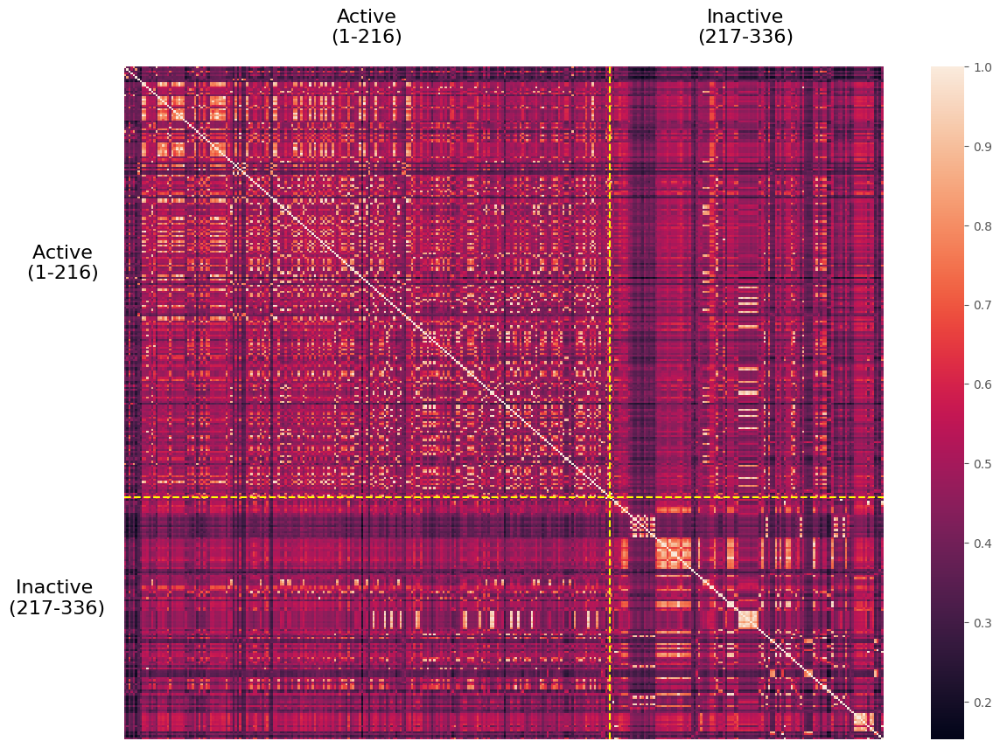

In [ ]:
import seaborn as sn

dataset_new = dataset_matrix.drop(['CID','Compound_Name','Smiles','Activity', 'Activity Value','Structure', 'tanimoto_values', 'm_fpt2'], axis=1)

dataset_slice =  dataset_new.iloc[:336,:336]

x = 335 # position of last inactive

dataset_slice.columns = [str(i) for i in range(x+1)]

m = 215 # position of last active

fig, ax = plt.subplots(figsize=(14, 10))

hm = sn.heatmap(data = dataset_slice, xticklabels = False, yticklabels = False)
hm.axhline(y=m, color='yellow', linestyle='--', linewidth=1.5)
hm.axvline(x=m, color='yellow', linestyle='--', linewidth=1.5)
plt.text(m/2, 0, 'Active\n(1-216)\n', color='black', rotation=0, va='bottom', ha='center', fontsize = 16)
plt.text(0, m/2, 'Active     \n(1-216)    ', color='black', rotation=0, va='bottom', ha='right', fontsize = 16)

plt.text((x+m)/2, 0, 'Inactive\n(217-336)\n', color='black', rotation=0, va='bottom', ha='center', fontsize = 16)
plt.text(0, (x+m)/2, 'Inactive     \n(217-336)   ', color='black', rotation=0, va='bottom', ha='right', fontsize = 16)
hm

The heatmap key indicates the range each similarity coefficient is in with a lighter color indicating "more similar."

When we generate these, we want to see that the majority of the heatmap is dark with a similarity coefficient < 0.6. It is ok if there are a few larger light clusters with high similarity coefficients; there will be some molecules that are quite similar.

By observing the heatmap for our data, we can conclude that we have indeed obtained a reliable dataset with a suitable training difficulty.